<a href="https://colab.research.google.com/github/NRC-Lund/radiation-WM/blob/main/WM_analysis_Power_Analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import display
import seaborn as sns

from matplotlib import style, offsetbox
import matplotlib.cm as cm
style.use('ggplot') or plt.style.use('ggplot')

import scipy.stats as stats
from scipy.cluster.hierarchy import dendrogram
from scipy.stats import ttest_ind
from statsmodels.stats.multitest import multipletests
from statsmodels.formula.api import ols
from statsmodels.stats.anova import anova_lm

import sklearn.feature_selection as featsel
from sklearn import (manifold, datasets, decomposition, ensemble,
                     discriminant_analysis, random_projection, neighbors, metrics)
from sklearn.cluster import KMeans, AgglomerativeClustering
from sklearn.preprocessing import scale, StandardScaler, MinMaxScaler
from sklearn.metrics import silhouette_score, confusion_matrix, f1_score, classification_report, accuracy_score
from sklearn.metrics.pairwise import euclidean_distances
from sklearn.feature_selection import (f_classif, VarianceThreshold, chi2, mutual_info_classif, SelectKBest,
                                       SelectPercentile)
from sklearn.cluster import KMeans, DBSCAN
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression

from ipywidgets import interact, widgets

import os

import time

import warnings
warnings.filterwarnings('ignore')


In [ ]:
#define seaborn background colors
#sns.despine();
sns.set_style("whitegrid")
plt.rcParams['axes.edgecolor'] = '#000000'
plt.rcParams['axes.labelsize'] = 18
plt.rcParams['xtick.labelsize'] = 14
plt.rcParams['ytick.labelsize'] = 14
plt.rcParams['font.family'] = 'sans-serif'
plt.rcParams['ytick.left'] = True
plt.rcParams['xtick.bottom'] = True
#plt.rcParams['ytick.labelleft'] = True

### Loading Data

In [ ]:
Colab_flag = True

In [ ]:
if Colab_flag:
  from google.colab import drive
  drive.mount('/content/drive')
  homeFolder = '/content/drive/MyDrive/Colab Notebooks/WM/'
else:
  homeFolder = '/Users/sbk/Documents/Lab/WM/'

picFolder = homeFolder + 'Pics/'

Mounted at /content/drive


#Behavior

In [ ]:
# Statistical evaluation
def getpval(df, var):
    # Hypothesis test: compare the means of two treatments
    treatment_a = df[(df['Treatment'] == 'Control') | (df['Treatment'] == 'CTRL')][var]
    treatment_b = df[df['Treatment'] == 'WB'][var]
    t_statistic, p_value = stats.mannwhitneyu(treatment_a, treatment_b, nan_policy='omit')
    return t_statistic, p_value


In [ ]:
def bootstrap_test(distribution1, distribution2):
    num_samples = 10000
    confidence_level = 0.95

    # Compute the observed statistic
    observed_statistic = np.mean(distribution1) - np.mean(distribution2)

    # Combine the two distributions
    combined_data = np.concatenate((distribution1, distribution2))

    # Initialize an array to store the bootstrap statistics
    bootstrap_statistics = np.zeros(num_samples)

    # Perform bootstrapping
    for i in range(num_samples):
        # Generate a bootstrap sample
        bootstrap_sample = np.random.choice(combined_data, size=len(combined_data), replace=True)

        # Compute the statistic for the bootstrap sample
        bootstrap_statistic = np.mean(bootstrap_sample[:len(distribution1)]) - np.mean(bootstrap_sample[len(distribution1):])

        # Store the bootstrap statistic
        bootstrap_statistics[i] = bootstrap_statistic

    # Compute the p-value
    p_value = (np.abs(bootstrap_statistics) >= np.abs(observed_statistic)).mean()

    # Compute the confidence interval
    alpha = (1 - confidence_level) / 2
    lower_bound = np.percentile(bootstrap_statistics, alpha * 100)
    upper_bound = np.percentile(bootstrap_statistics, (1 - alpha) * 100)

    # Return the observed statistic, p-value, and confidence interval
    return observed_statistic, p_value, (lower_bound, upper_bound)

#observed_statistic, p_value, confidence_interval = bootstrap_test(distribution1, distribution2)

#print("Observed statistic:", observed_statistic)
#print("P-value:", p_value)
#print("Confidence interval:", confidence_interval)


In [ ]:
def remove_outliers(df, column_name, multiplier=1.5):
    """
    Remove outliers from a specific column in a DataFrame using the IQR method.

    Parameters:
    - df (pd.DataFrame): The input DataFrame.
    - column_name (str): The name of the column from which outliers will be removed.
    - multiplier (float): The multiplier to determine the outlier threshold (default is 1.5).

    Returns:
    - pd.DataFrame: DataFrame without outliers in the specified column.
    """

    # Select the specified column
    column_data = df[column_name]

    # Calculate the IQR (Interquartile Range)
    Q1 = column_data.quantile(0.25)
    Q3 = column_data.quantile(0.75)
    IQR = Q3 - Q1

    # Define the lower and upper bounds for outliers
    lower_bound = Q1 - multiplier * IQR
    upper_bound = Q3 + multiplier * IQR

    # Filter out rows with values outside the bounds
    df_filtered = df[(column_data >= lower_bound) & (column_data <= upper_bound)]

    return df_filtered


In [ ]:
def ttxpalette(bTtx):
  TtxNames = ['Control', 'CS', 'HF', 'WB'];
  #colors2 = ['#3f51b5', '#ffa700', '#34a853', '#ea4335'];
  colors2 = ['#3f51b5', '#ffa700', '#ffa700', '#ffa700'];

  # Create a dictionary to map TtxNames to colors
  color_dict = {ttx: color for ttx, color in zip(TtxNames, colors2)}

  # Create a list of colors corresponding to TtxNames
  bpalette = [color_dict[ttx] for ttx in bTtx]

  # Set the seaborn palette
  sns.set_palette(bpalette)

  return bpalette

def epochpalette(bEpoch = ['Start', 'Cue', 'Running', 'Reward', 'Timeout']):
  EpochNames = ['Start', 'Cue', 'Running', 'Reward', 'Timeout', 'TimeOut'];
  colors2 = ['#d11141', '#00b159', '#00aedb', '#f37735', '#767676', '#767676'];

  # Create a dictionary to map TtxNames to colors
  color_dict = {ex: color for ex, color in zip(EpochNames, colors2)}

  # Create a list of colors corresponding to TtxNames
  bpalette = [color_dict[ex] for ex in bEpoch]

  # Set the seaborn palette
  sns.set_palette(bpalette)

  return bpalette

def epochpalette2(bEpoch = ['Start', 'Cue', 'Running', 'Outcome', 'Timeout']):
  EpochNames = ['Start', 'Cue', 'Running', 'Reward', 'Outcome', 'TimeOut'];
  colors2 = ['#d11141', '#00b159', '#00aedb', '#f37735', '#767676', '#767676'];

  # Create a dictionary to map TtxNames to colors
  color_dict = {ex: color for ex, color in zip(EpochNames, colors2)}

  # Create a list of colors corresponding to TtxNames
  bpalette = [color_dict[ex] for ex in bEpoch]

  # Set the seaborn palette
  sns.set_palette(bpalette)

  return bpalette

def strpalette(bStructure = ['plPFC', 'ilPFC', 'OFC', 'M2', 'DLS', 'NAcCore', 'PPC', 'dHipp', 'vHipp', 'MDT']):
  StrNames = ['plPFC', 'ilPFC', 'OFC', 'M2', 'DLS', 'NAcCore', 'nAc', 'PPC', 'dHipp', 'vHipp', 'MDT']
  colors2 = ['#ff1000', '#ff5000', '#ff8000', '#ffaf00', '#52b855', '#245923', '#245923', '#3f20c0', '#3f63c0', '#3fa7c0', '#800eec'];

  # Create a dictionary to map TtxNames to colors
  color_dict = {ex: color for ex, color in zip(StrNames, colors2)}

  # Create a list of colors corresponding to TtxNames
  bpalette = [color_dict[ex] for ex in bStructure]

  # Set the seaborn palette
  sns.set_palette(bpalette)

  return bpalette


In [ ]:
def sigSymbol(P):
  if P >= 0.05:
    sig = ' '
  else:
    if P <= 0.0001:
      sig = '***'
    elif (P <= 0.001) & (P > 0.0001):
      sig = '**'
    else:
      sig = '*'
  return sig

## Performance Analysis

In [ ]:
path = homeFolder + 'FractalTable.csv'
L= pd.read_csv(path)
L.head(3)

,Rec,nTrial,Trial,Epoch,Treatment,Hemisphere,Structure,Speed,Acc,Theta,Beta,Gamma,fTheta,fBeta,fGamma
0,Rec1,1,HIT,Start,Control,L,DLS,18.851702,0.084503,-0.886042,-0.853218,0.569239,5.75,20.0,47.00
1,Rec1,2,HIT,Start,Control,L,DLS,5.385658,0.087147,-0.803077,0.335654,0.908059,4.25,17.5,49.75
2,Rec1,3,HIT,Start,Control,L,DLS,0.180555,0.091434,0.254699,-1.212263,1.390533,6.25,16.5,43.75


In [ ]:
bHemi = np.unique(L.Hemisphere)
bRec = np.unique(L.Rec)
bStructure = ['plPFC', 'OFC', 'DLS', 'NAcCore', 'PPC', 'dHipp', 'MDT']
bEpoch = ['Start', 'Cue', 'Running', 'Reward', 'TimeOut']

rec = []
ttx = []
perf = []
ntrials = []

for rx in range(len(bRec)):
    idx = 0
    dummy = L[(L.Hemisphere == bHemi[0]) &
              (L.Rec == bRec[rx]) &
              (L.Structure == bStructure[idx]) &
              (L.Epoch == bEpoch[0])]

    if len(dummy) == 0:
        while True:
            idx = idx + 1
            if idx >= len(bStructure):
                break

            dummy = L[(L.Hemisphere == bHemi[0]) &
                      (L.Rec == bRec[rx]) &
                      (L.Structure == bStructure[idx]) &
                      (L.Epoch == bEpoch[0])]

            if len(dummy) > 0:
                break

    xresp = np.nansum(dummy.Trial == 'HIT') / len(dummy)
    perf.append(xresp)
    ttx.append(np.unique(dummy.Treatment)[0])  # fix to append the actual treatment value
    rec.append(bRec[rx])
    ntrials.append(np.nansum(len(dummy)))

df = pd.DataFrame({'Rec': rec, 'Treatment': ttx, 'Performance': perf, 'NTrials': ntrials})


In [ ]:
TtxNames = ['Control', 'WB']

In [ ]:
from scipy.optimize import curve_fit

# Define the sigmoid function
def sigmoid(x, a, b, c, d):
    y = c / (1 + np.exp(-a*(x-b))) + d
    return y

df2 = df[(df.Performance > 0.3)]
mask = (df2.Performance > 0.5) & (df2.NTrials < 15)
df2 = df2[~mask];

df2.reset_index(inplace = True, drop = True)
# Define the data to fit
xdata = df2['NTrials']
ydata = df2['Performance']

# Set initial parameter values for the sigmoid function
p0 = [1, np.mean(xdata), 1, np.mean(ydata)]

# Fit the sigmoid function to the data using 'lm' method
popt, pcov = curve_fit(sigmoid, xdata, ydata, p0, method='lm')


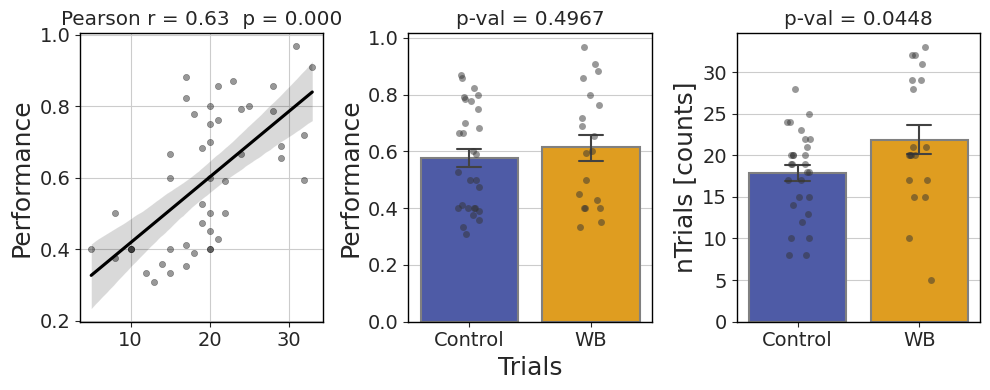

In [ ]:
fig, ax = plt.subplots(1, 3, figsize=(10,4))
bTtx = TtxNames
#Learning curve:
hax = ax[0]
sns.scatterplot(data = df2, x = 'NTrials', y  = 'Performance', ax = hax, s = 20, color = '.2', edgecolor = 'k', alpha = 0.5);
sns.regplot(data=df2, x='NTrials', y='Performance', ax=hax, color = 'black', scatter = False)
hax.set_xlabel(None)
hax.set_ylabel('Performance')

# Add Pearson correlation coefficient and significance
r, p = stats.pearsonr(df2['NTrials'], df2['Performance'])
textstr = f'Pearson r = {r:.2f}  p = {p:.3f}'
hax.set_title(textstr);

#Performance comparison:
hax = ax[1]
#sns.boxplot(data=df2, x='Treatment', y='Performance', linewidth = 1.5, ax = hax, palette = ttxpalette(TtxNames))
sns.barplot(data=df2, x='Treatment', y='Performance', ax = hax,capsize=.2, errwidth = 1.5, linewidth=1.5, edgecolor=".5", palette = ttxpalette(bTtx), ci=68)
sns.stripplot(data=df2, x='Treatment', y='Performance', s = 5, ax = hax, color = '.2', edgecolor = 'k', alpha = 0.5)
hax.set_xlabel('Trials')
hax.set_ylabel('Performance')
# add significance annotation to the boxplot
for i, treatment in enumerate(df2.Treatment.unique()):
    group1 = df2[df2.Treatment == treatment]['Performance']
    for j, treatment2 in enumerate(df2.Treatment.unique()):
        if j > i:
            group2 = df2[df2.Treatment == treatment2]['Performance']
            pval = stats.ttest_ind(group1, group2).pvalue
            if pval < 0.05:
                hax.annotate("*", xy=(i, np.max([group1.max(), group2.max()])+0.02), fontsize=20, ha='center')
hax.set_title(f'p-val = {pval:.4f}');


#Number of trials comparison:
hax = ax[2]
#sns.boxplot(data=df2, x='Treatment', y='NTrials', linewidth = 1.5, ax = hax, palette = ttxpalette(TtxNames))
sns.barplot(data=df2, x='Treatment', y='NTrials', ax = hax,capsize=.2, errwidth = 1.5, linewidth=1.5, edgecolor=".5", palette = ttxpalette(bTtx), ci=68)
sns.stripplot(data=df2, x='Treatment', y='NTrials', s = 5, ax = hax, color = '.2', edgecolor = 'k', alpha = 0.5)
hax.set_xlabel(None)
hax.set_ylabel('nTrials [counts]')

# add significance annotation to the boxplot
for i, treatment in enumerate(df2.Treatment.unique()):
    group1 = df2[df2.Treatment == treatment]['NTrials']
    for j, treatment2 in enumerate(df2.Treatment.unique()):
        if j > i:
            group2 = df2[df2.Treatment == treatment2]['NTrials']
            pval = stats.ttest_ind(group1, group2).pvalue
            if pval < 0.05:
                hax.annotate("*", xy=(i, np.max([group1.max(), group2.max()])+50), fontsize=20, ha='center')
hax.set_title(f'p-val = {pval:.4f}');


plt.tight_layout()
fname = picFolder + 'Perf_1.png'
plt.savefig(fname, dpi=200, format=None, metadata=None,
        bbox_inches=None, pad_inches=0.1,
        facecolor='white', edgecolor='auto',
        backend=None)
plt.show()


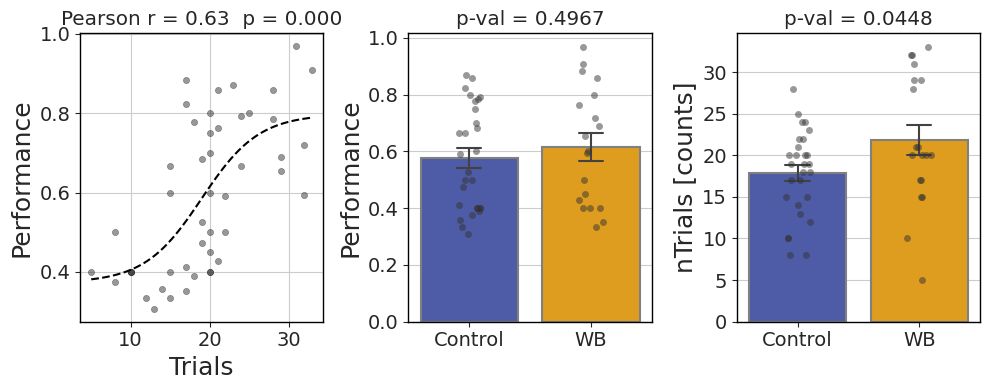

In [ ]:
fig, ax = plt.subplots(1, 3, figsize=(10,4))

#Learning curve:
hax = ax[0]
sns.scatterplot(data = df2, x = 'NTrials', y  = 'Performance', ax = hax, s = 20, color = '.2', edgecolor = 'k', alpha = 0.5);
x = np.linspace(np.min(xdata), np.max(xdata), 100)
y = sigmoid(x, *popt)
hax.plot(x, y, color='black', linestyle='--')
hax.set_ylabel('Performance')
hax.set_xlabel('Trials')

# Add Pearson correlation coefficient and significance
r, p = stats.pearsonr(df2['NTrials'], df2['Performance'])
textstr = f'Pearson r = {r:.2f}  p = {p:.3f}'
hax.set_title(textstr);

#Performance comparison:
hax = ax[1]
sns.barplot(data=df2, x='Treatment', y='Performance', ax = hax,capsize=.2, errwidth = 1.5, linewidth=1.5, edgecolor=".5", palette = ttxpalette(bTtx), ci=68)
sns.stripplot(data=df2, x='Treatment', y='Performance', s = 5, ax = hax, color = '.2', edgecolor = 'k', alpha = 0.5)

# add significance annotation to the boxplot
for i, treatment in enumerate(df2.Treatment.unique()):
    group1 = df2[df2.Treatment == treatment]['Performance']
    for j, treatment2 in enumerate(df2.Treatment.unique()):
        if j > i:
            group2 = df2[df2.Treatment == treatment2]['Performance']
            pval = stats.ttest_ind(group1, group2).pvalue
            if pval < 0.05:
                hax.annotate("*", xy=(i, np.max([group1.max(), group2.max()])+0.02), fontsize=20, ha='center')
hax.set_title(f'p-val = {pval:.4f}');
hax.set_xlabel(None)
hax.set_ylabel('Performance')

#Number of trials comparison:
hax = ax[2]
sns.barplot(data=df2, x='Treatment', y='NTrials', ax = hax,
            capsize=.2, errwidth = 1.5, linewidth=1.5, edgecolor=".5", palette = ttxpalette(bTtx), ci=68)
sns.stripplot(data=df2, x='Treatment', y='NTrials', s = 5, ax = hax, color = '.2', edgecolor = 'k', alpha = 0.5)

# add significance annotation to the boxplot
for i, treatment in enumerate(df2.Treatment.unique()):
    group1 = df2[df2.Treatment == treatment]['NTrials']
    for j, treatment2 in enumerate(df2.Treatment.unique()):
        if j > i:
            group2 = df2[df2.Treatment == treatment2]['NTrials']
            pval = stats.ttest_ind(group1, group2).pvalue
            if pval < 0.05:
                hax.annotate("*", xy=(i, np.max([group1.max(), group2.max()])+50), fontsize=20, ha='center')
hax.set_title(f'p-val = {pval:.4f}');
hax.set_xlabel(None)
hax.set_ylabel('nTrials [counts]')

plt.tight_layout()
fname = picFolder + 'Perf_2.png'
plt.savefig(fname, dpi=200, format=None, metadata=None,
        bbox_inches=None, pad_inches=0.1,
        facecolor='white', edgecolor='auto',
        backend=None)
plt.show()


### Remove sessions with low performance:

In [ ]:
#Select only the recordings that fit
dummy = df2[(df2.Performance > 0.5)]
Data = L[np.in1d(L.Rec, dummy.Rec)]
Data.dropna(subset = 'Theta', inplace = True);
Data.Epoch[Data.Epoch == 'Reward'] = 'Outcome'
Data.reset_index(inplace = True, drop = True);
bStructure = ['plPFC', 'OFC', 'DLS', 'NAcCore', 'PPC', 'dHipp', 'MDT']


In [ ]:
Data.head()

,Rec,nTrial,Trial,Epoch,Treatment,Hemisphere,Structure,Speed,Acc,Theta,Beta,Gamma,fTheta,fBeta,fGamma
0,Rec2,1,FAIL,Start,Control,L,DLS,0.094300,0.084804,-1.039065,-0.447568,2.546750,7.25,13.25,52.00
1,Rec2,2,HIT,Start,Control,L,DLS,0.681684,0.087926,-0.452179,-0.535960,1.237189,5.50,11.75,53.25
2,Rec2,3,HIT,Start,Control,L,DLS,0.471345,0.062366,-0.956862,-1.695613,0.469806,7.50,19.00,59.25
3,Rec2,4,HIT,Start,Control,L,DLS,0.314069,0.196169,-0.457059,-0.315299,3.147520,6.00,16.00,47.75
4,Rec2,5,HIT,Start,Control,L,DLS,0.140320,0.063424,-0.475588,0.329511,2.455362,4.00,16.25,52.00


## FFT

In [ ]:
sourceFolder = homeFolder
Hemisphere = ['L', 'R'];
bStructure = ['plPFC', 'OFC', 'DLS', 'NAcCore', 'PPC', 'dHipp', 'MDT']
#bEpoch = ['Start', 'Cue', 'Running', 'Reward', 'TimeOut']
bEpoch = ['Start', 'Cue', 'Running', 'Outcome', 'TimeOut']

rawpath = f'{sourceFolder}RawSpectra.csv';

rewriteFlag = False;
if (os.path.isfile(rawpath)) & (rewriteFlag == False):
    print('Table found')
    Spectra = pd.read_csv(rawpath);
    print('Loaded')
else:
    Spectra = pd.DataFrame();
    for recId in range(98):
        for hx in range(2):
            hemi = Hemisphere[hx];
            path = sourceFolder + f'Spectra_Rec{recId}_{hemi}.csv'
            if os.path.isfile(path):
                LoadT= pd.read_csv(path)
                LoadT['Hemisphere'] = np.repeat(hemi,len(LoadT));
                Spectra = Spectra.append(LoadT,ignore_index=True);

    Spectra.to_csv(rawpath, index=False)



Table found
Loaded


In [ ]:
dummy = df2[(df2.Performance > 0.5)].reset_index(drop = True)
Spectra = Spectra[np.in1d(Spectra.Rec, dummy.Rec)]

Spectra.head(3)

,Rec,Structure,Epoch,Trial,Outcome,Ttx,Freq,Spectra,Hemisphere
113280,Rec2,NAcCore,Start,1,0,Control,1.220703,1.073921,L
113281,Rec2,NAcCore,Start,1,0,Control,1.464844,1.149831,L
113282,Rec2,NAcCore,Start,1,0,Control,1.708984,1.325300,L


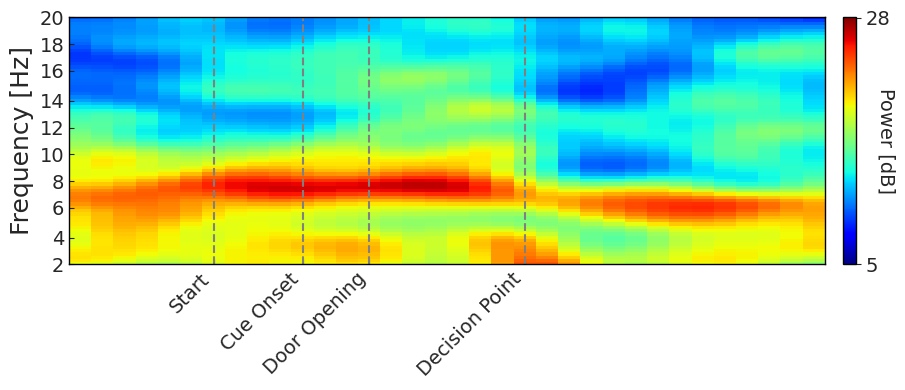

In [ ]:
import scipy.io
import matplotlib.pyplot as plt

# Load the .mat file
mat_data = scipy.io.loadmat(f'{sourceFolder}FFT/Rec10_L_NAcCore_Trial12.mat')

taxis = np.array(mat_data['taxis'].squeeze())
faxis = np.array(mat_data['faxis'][0])
data = mat_data['data']
ev = np.array(mat_data['evmarks'].squeeze())

fig, ax = plt.subplots(1, 1, figsize=(10, 4))
vmin = 5
vmax = 28
im = ax.imshow(data, aspect='auto', cmap='jet', vmin = vmin, vmax = vmax)

# Set tick labels
# Use a loop for multiple vlines
idx = []
yval = []
for x in [2,4,6,8,10,12,14,16,18,20]:
  idx.append(np.argmin(np.abs(faxis - x)))
  yval.append(x)

ax.set_yticks(idx)
ax.set_yticklabels(yval)

YLim = [2, 20];
ax.set_ylim([np.argmin(np.abs(faxis - YLim[0])), np.argmin(np.abs(faxis - YLim[1]))])
#ax.invert_yaxis()

# Use a loop for multiple vlines
idx = []
xval = []
for x in ev:
  idx.append(np.argmin(np.abs(taxis - x)))
  xval.append(round(x))
  ax.axvline(x=np.argmin(np.abs(taxis - x)), color='gray', linestyle='--', linewidth=1.5)

ax.set_xticks(idx)
ax.set_xticklabels(['Start', 'Cue Onset', 'Door Opening', 'Decision Point'],
                   rotation = 45, horizontalalignment = 'right')
ax.grid(False)

cbar = fig.colorbar(im, ax=ax, pad = 0.02)
cbar.set_ticks([vmin, vmax])
cbar.set_ticklabels([vmin, vmax])
cbar.set_label('Power [dB]\n', fontsize=14, rotation = 270)  # You can customize the label as needed


#plt.xlabel('Time (s)')
plt.ylabel('Frequency [Hz]')
ax.tick_params(axis = 'both', direction='in')

fname = picFolder + f'Example_Spectrogram.png'
plt.tight_layout()
plt.savefig(fname, dpi=200, format=None, metadata=None, bbox_inches=None, pad_inches=0.1, facecolor='white', edgecolor='auto', backend=None)
plt.show()


In [ ]:
signal = pd.read_csv(sourceFolder + 'FFT/Signal_Rec50_L.csv')
signal.head(3)

,taxis,trial,NAcCore,Acc,dHipp,OFC,plPFC,ilPFC,MDT,M2,PPC,DLS
0,374.9800,1,-125.81630,0.098839,-40.563100,-207.2125,2.111231,75.22211,116.2728,-66.483180,17.70190,-50.15761
1,374.9805,1,-89.56841,0.098839,-20.089300,-172.3974,29.994270,96.29424,139.0282,-32.409180,46.58368,-23.29217
2,374.9810,1,-30.50754,0.098839,9.165621,-120.6344,73.619020,117.58480,151.4440,7.864589,75.27612,14.01246


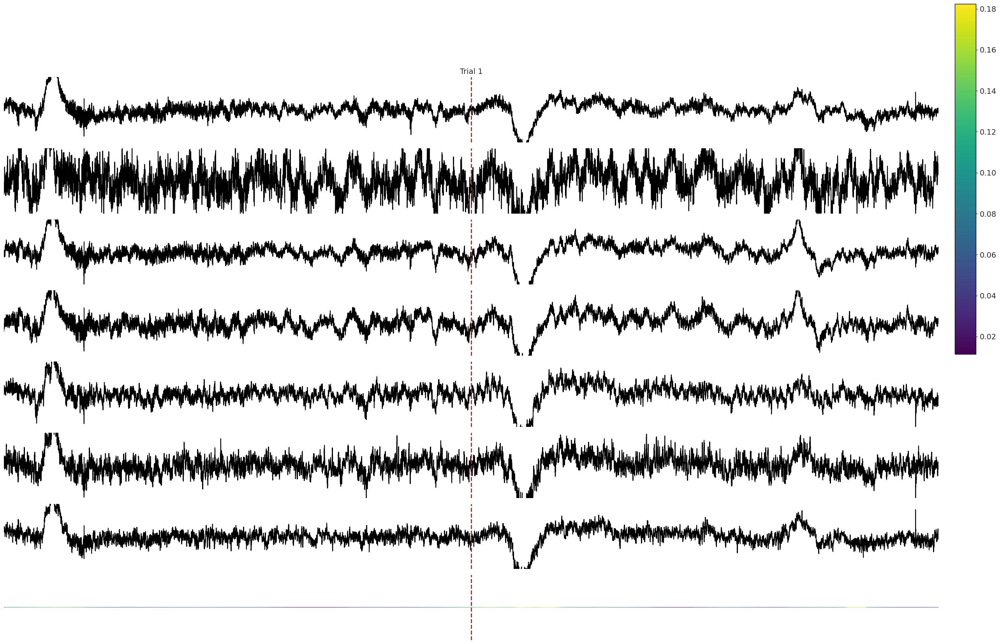

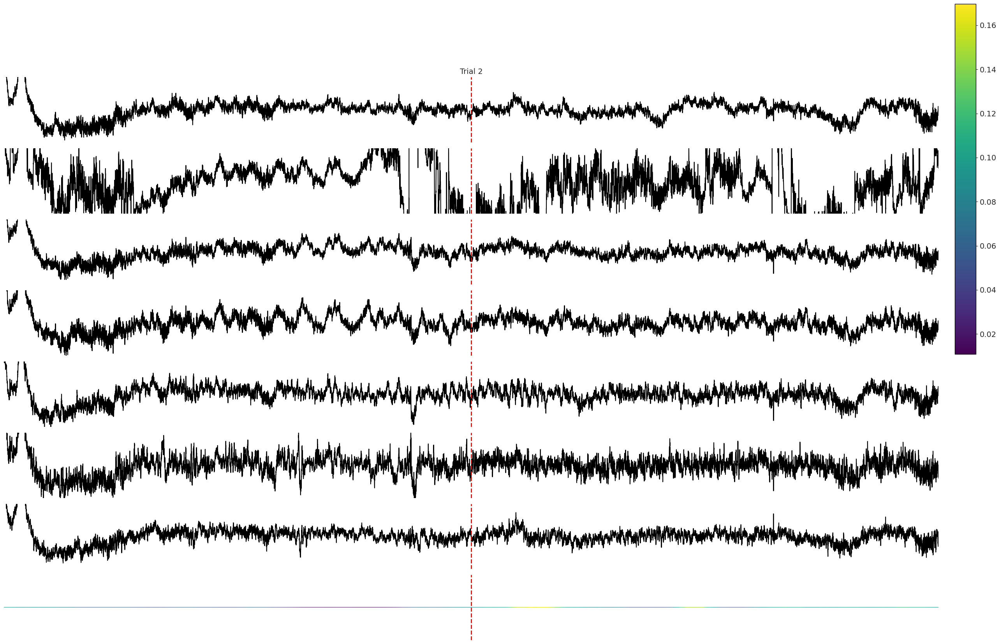

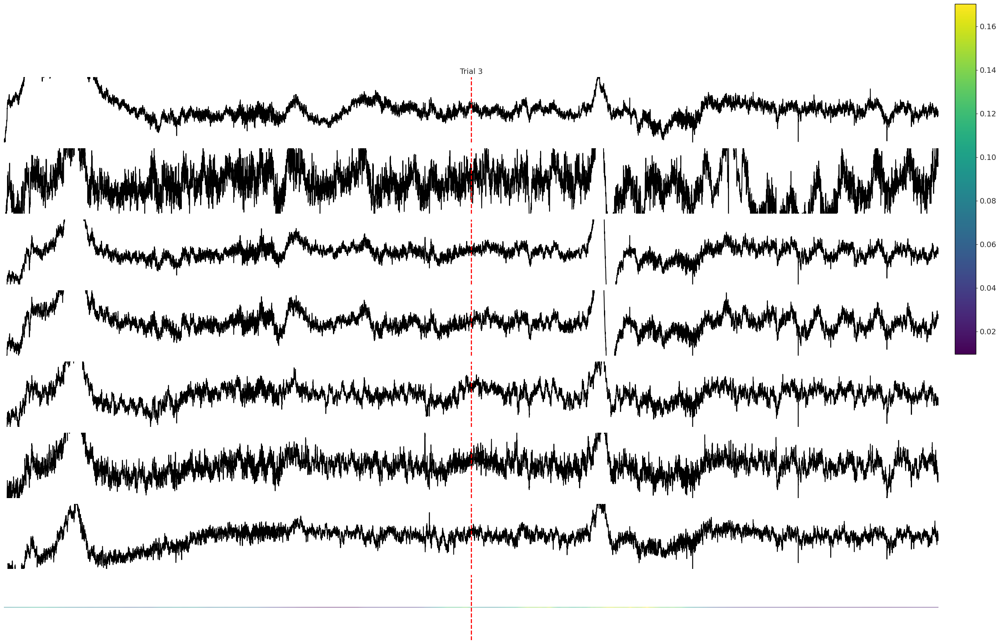

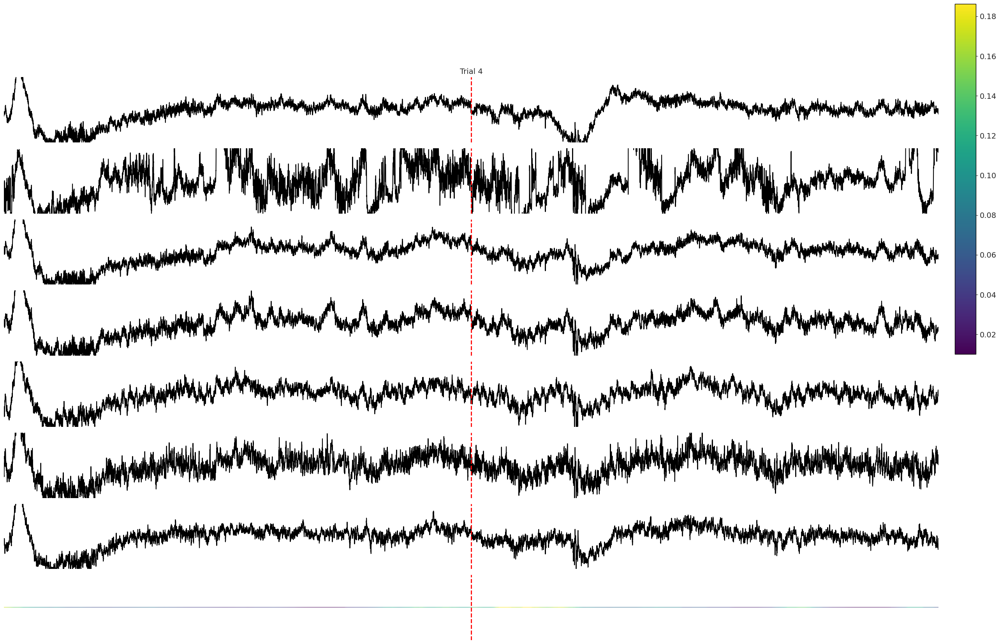

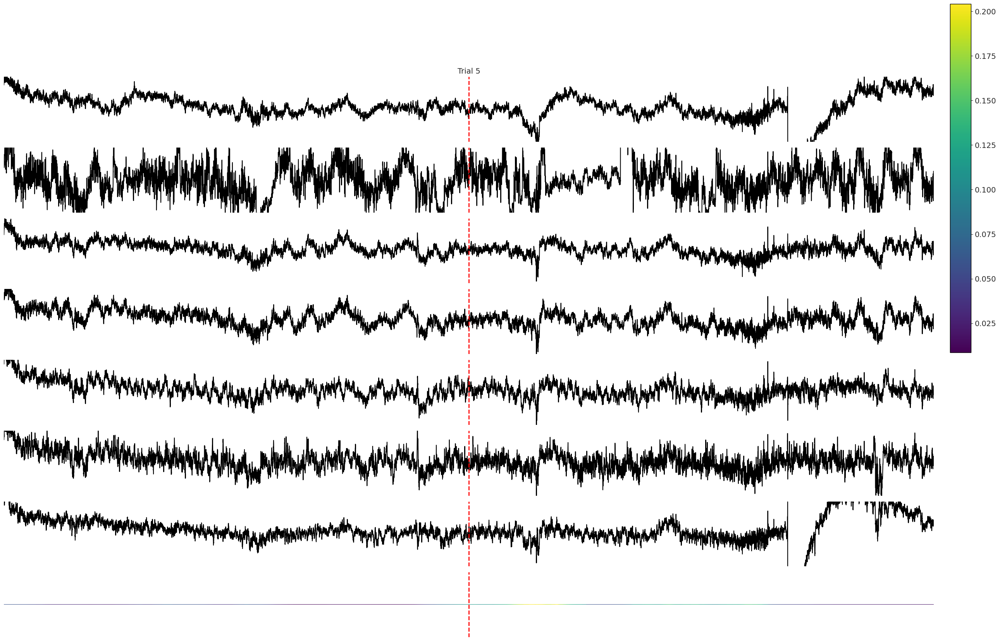

...

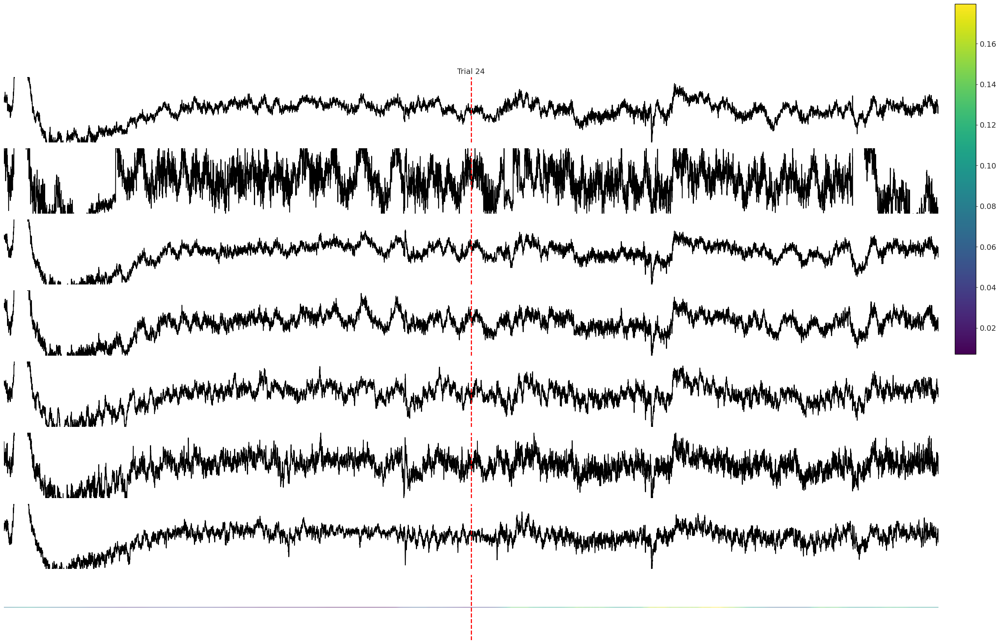

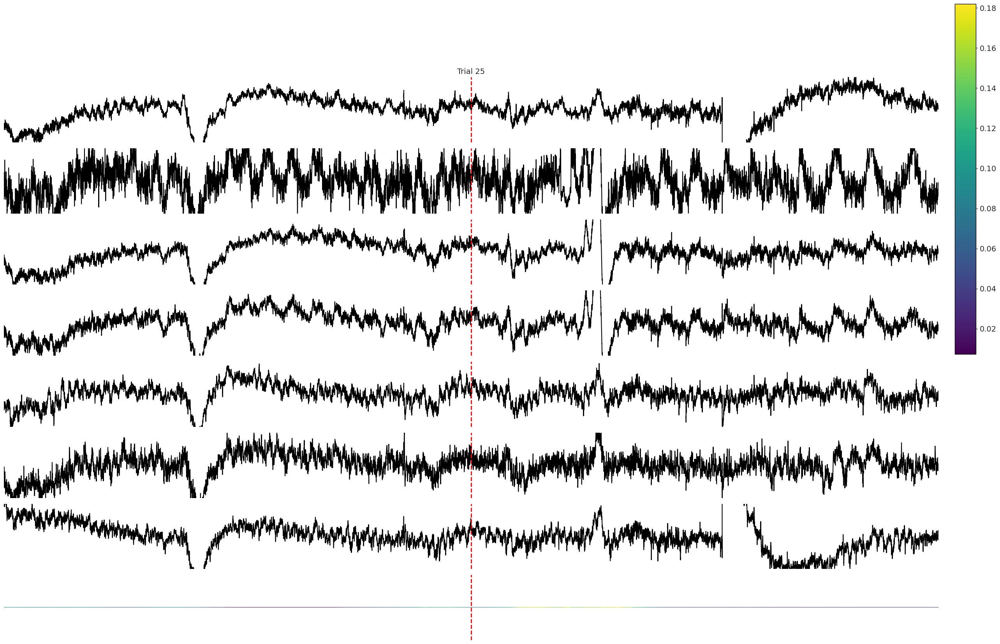

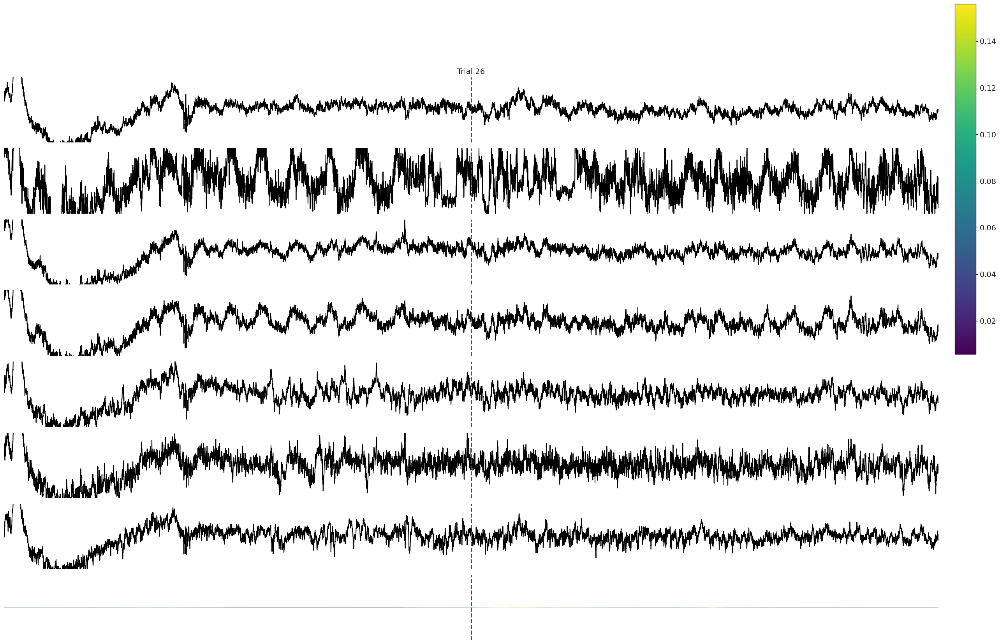

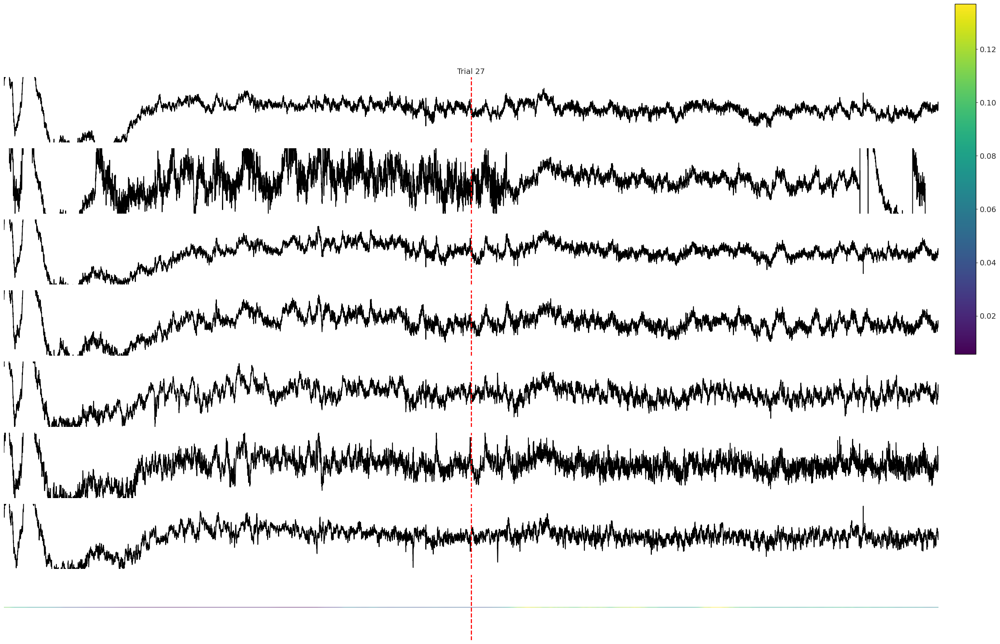

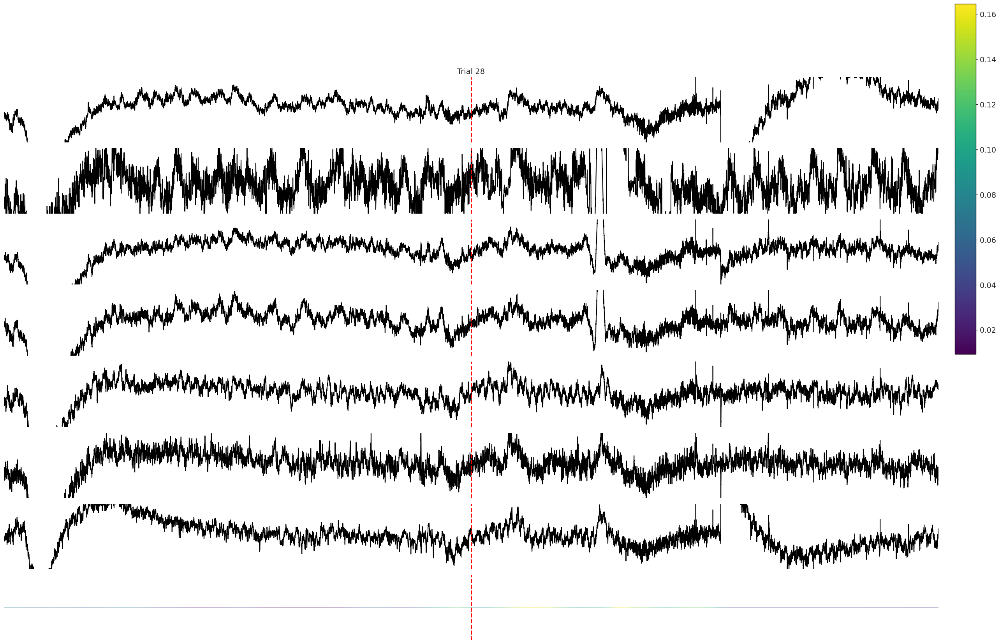

"\n      if structure == 'dHipp':\n          hax.set_ylim([-100, 100])\n      elif structure == 'DLS':\n          hax.set_ylim([-200, 200])\n      elif structure == 'Acc':\n          hax.set_ylim([0, 0.4])\n      else:\n          hax.set_ylim([-300, 300])\n\n"

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

#Labels = ['NAcCore', 'dHipp', 'OFC', 'plPFC', 'MDT', 'DLS', 'Acc']
Labels = ['plPFC', 'OFC', 'DLS', 'NAcCore', 'PPC', 'dHipp', 'MDT', 'Acc']

for k in np.unique(signal.trial):
  bdf = signal[signal.trial == k]

  fig, ax = plt.subplots(len(Labels), 1, figsize=(27, 15), sharex=True)

  # Calculate the midpoint of the time axis
  midpoint = (bdf.taxis.min() + bdf.taxis.max()) / 2

  for ix, structure in enumerate(Labels):
      hax = ax[ix]
      if structure == 'Acc':
          dummy = np.array(bdf.Acc)
          dummy = dummy.reshape(-1, 1)
          # Plot the heatmap with the time axis
          im = hax.imshow(dummy.T, aspect='auto', cmap='viridis', extent=[bdf.taxis.min(), bdf.taxis.max(), 0, 1])
          hax.set_yticks([])
          hax.set_ylabel(structure, rotation=0, labelpad=50, fontsize=16, va='center')
      else:
        if structure in bdf.columns:
            sns.lineplot(data=bdf, x='taxis', y=structure, ax=hax, color='k')
            hax.set_ylabel(structure, rotation=0, labelpad=50, fontsize=16, va='center')

      # Draw the vertical line at the midpoint
      hax.axvline(x=midpoint, color='red', linestyle='--', linewidth = 2)

      hax.set_ylim([-500, 500])

      hax.set_axis_off()
      hax.set_yticklabels([])
      hax.grid(None)

      if ix == 0:
        hax.set_title(f'Trial {k}', fontsize = 14)

  # Add colorbar for the heatmap
  # Add colorbar for the heatmap
 # cbar_ax = fig.add_axes([0.91, 0.2, 0.02, 0.6])
  cbar_ax = fig.add_axes([0.91, 0.5, 0.02, 0.6])
  fig.colorbar(im, cax=cbar_ax)

  # Set tight layout
  fname = picFolder + f'Example_LFP.png'
  plt.tight_layout(rect=[0, 0, 0.9, 1])
  #plt.savefig(fname, dpi=200, pad_inches=0.1, facecolor='white', edgecolor='auto')
  plt.show()

'''
      if structure == 'dHipp':
          hax.set_ylim([-100, 100])
      elif structure == 'DLS':
          hax.set_ylim([-200, 200])
      elif structure == 'Acc':
          hax.set_ylim([0, 0.4])
      else:
          hax.set_ylim([-300, 300])

'''

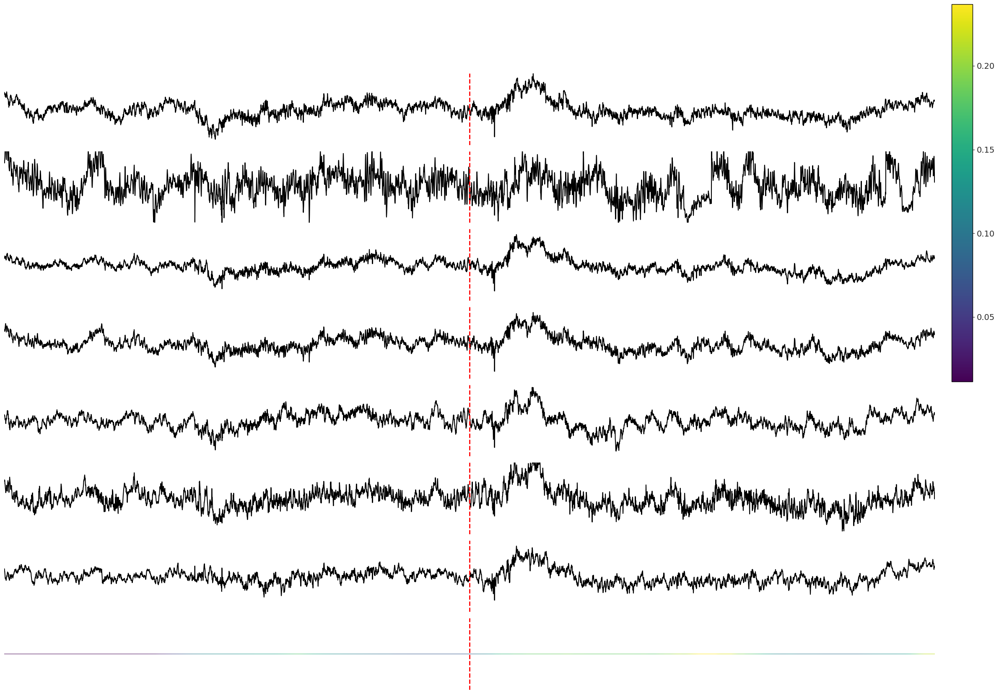

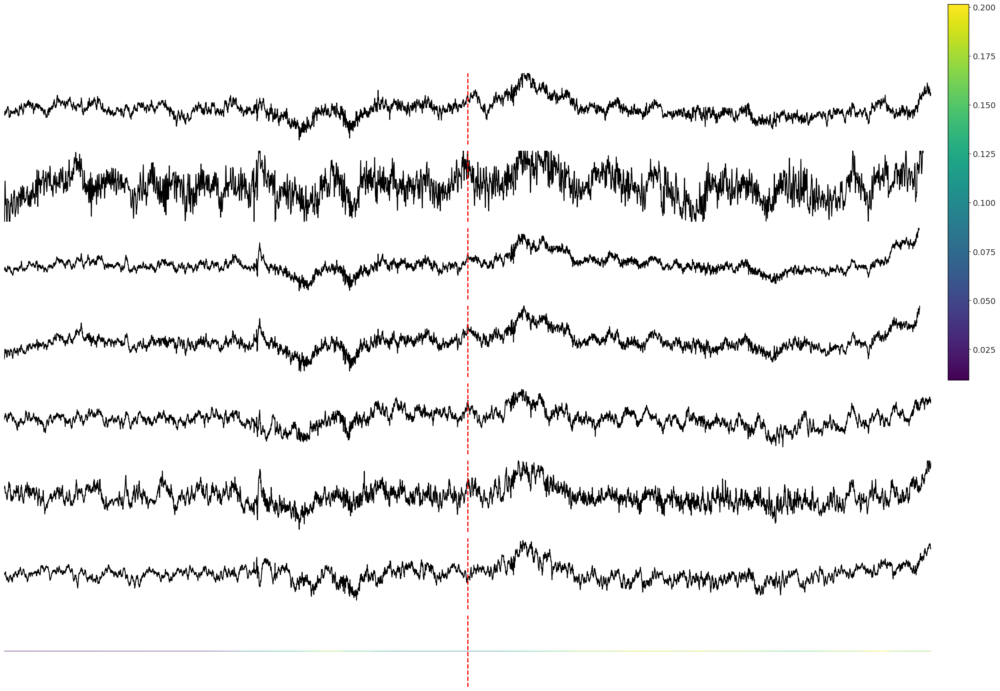

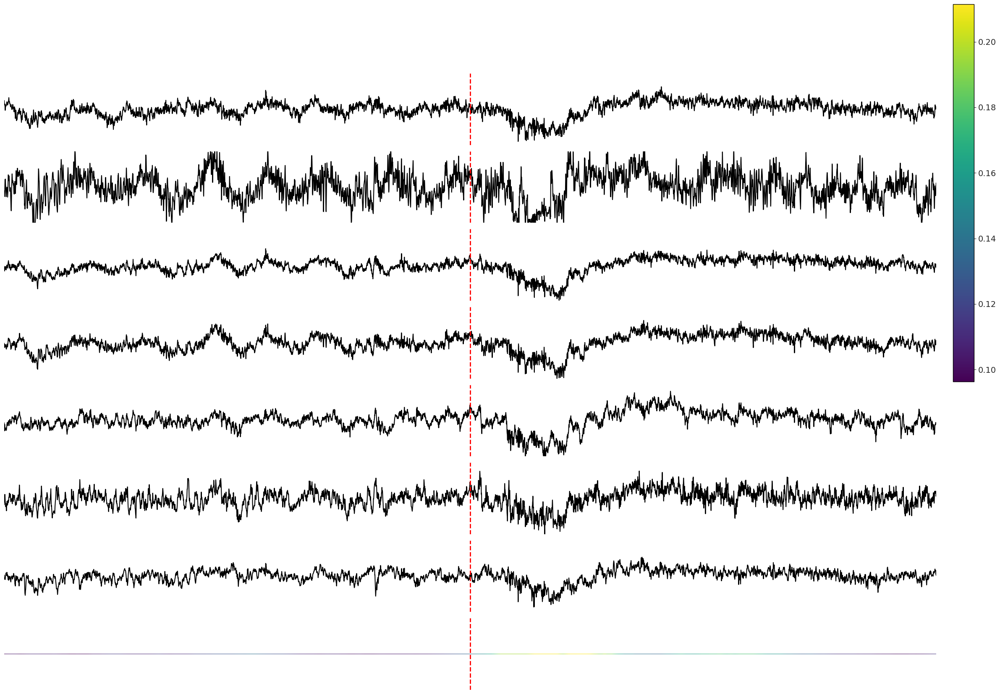

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

#Labels = ['NAcCore', 'dHipp', 'OFC', 'plPFC', 'MDT', 'DLS', 'Acc']
Labels = ['ilPFC', 'OFC', 'DLS', 'NAcCore', 'PPC', 'dHipp', 'MDT', 'Acc']

#for k in np.unique(signal.trial):
for k in [8, 12, 16]:
  bdf = signal[signal.trial == k]
  midpoint = (bdf.taxis.min() + bdf.taxis.max()) / 2
  bdf.taxis = bdf.taxis - midpoint -0.5
  bLim = (-3, 3)
  bdf = bdf[(bdf.taxis >= bLim[0]) & (bdf.taxis <= bLim[1])]

  fig, ax = plt.subplots(len(Labels), 1, figsize=(25, 15), sharex=True)

  # Calculate the midpoint of the time axis

  for ix, structure in enumerate(Labels):
      hax = ax[ix]
      if structure == 'Acc':
          dummy = np.array(bdf.Acc)
          dummy = dummy.reshape(-1, 1)
          # Plot the heatmap with the time axis
          #im = hax.imshow(dummy.T, aspect='auto', cmap='viridis', extent=[bdf.taxis.min(), bdf.taxis.max(), 0, 1])
          im = hax.imshow(dummy.T, aspect='auto', cmap='viridis', extent=[bLim[0], bLim[1], 0, 1])
          hax.set_yticks([])
          hax.set_ylabel(structure, rotation=0, labelpad=50, fontsize=16, va='center')
      else:
          sns.lineplot(data=bdf, x='taxis', y=structure, ax=hax, color='k')
          hax.set_ylabel(structure, rotation=0, labelpad=50, fontsize=16, va='center')

      # Draw the vertical line at the midpoint
      #hax.axvline(x=midpoint, color='red', linestyle='--', linewidth = 2)
      hax.axvline(x=0, color='red', linestyle='--', linewidth = 2)

      hax.set_ylim([-550, 550])

      hax.set_axis_off()
      hax.set_yticklabels([])
      hax.grid(None)

  # Add colorbar for the heatmap
 # cbar_ax = fig.add_axes([0.91, 0.2, 0.02, 0.6])
  cbar_ax = fig.add_axes([0.91, 0.5, 0.02, 0.6])
  fig.colorbar(im, cax=cbar_ax)

  # Set tight layout
  fname = picFolder + f'Example_LFP_{k}.png'
  plt.tight_layout(rect=[0, 0, 0.9, 1])
  plt.savefig(fname, dpi=200, pad_inches=0.1, facecolor='white', edgecolor='auto')
  plt.show()


In [ ]:
replotFlag = False

In [ ]:
Spectra.Epoch[Spectra.Epoch == 'Reward'] = 'Outcome'

In [ ]:
np.unique(Spectra.Epoch)

array(['Cue', 'Outcome', 'Running', 'Start', 'TimeOut'], dtype=object)

In [ ]:
from mpl_toolkits.axes_grid1.inset_locator import zoomed_inset_axes, mark_inset
from mpl_toolkits.axes_grid1.anchored_artists import AnchoredSizeBar


fname = picFolder + 'Global_PSD.png'

if replotFlag:
  fig, ax = plt.subplots(1,2,figsize = (8,5), sharey = True)
  bEpoch = ['Start', 'Cue', 'Running', 'Outcome', 'TimeOut']
  #bEpoch = ['Start', 'Cue', 'Running', 'Reward']
  for ix, ttx in enumerate(TtxNames):
    #sel = (Spectra.Ttx == ttx) & (Spectra.Outcome == True);
    sel = (Spectra.Ttx == ttx) & (Spectra.Structure != 'PPC');
    hax = ax[ix]
    sns.lineplot(data = Spectra[sel], ax = hax, x = 'Freq', y = 'Spectra', hue = 'Epoch', palette = epochpalette2(bEpoch))
    hax.set_title(f'{ttx}')
    hax.legend(loc = 'lower left').set_title(None)
    hax.set_xlabel('Frequency [Hz]')
    hax.set_ylabel('Power Spectral Density [V$^2$/Hz]')

    # sub region of the original image
    x1, x2, y1, y2 = 4, 9, 1.5, 2.2
    if ix == 0:
      y1 = 1.25
      y2 = 2
    #axins2 = zoomed_inset_axes(hax, 3, loc='upper right', bbox_to_anchor=(0.5,0.5))  # zoom = 6
    axins = hax.inset_axes([0.5, 0.5, 0.47, 0.47], xlim=(x1, x2), ylim=(y1, y2), xticklabels=[], yticklabels=[])
    sns.lineplot(data = Spectra[sel], ax = axins, x = 'Freq', y = 'Spectra', hue = 'Epoch', palette = epochpalette2(bEpoch))
    hax.indicate_inset_zoom(axins, edgecolor="black")
    axins.set_xlabel(None)
    axins.set_ylabel(None)
    axins.legend([],[], frameon=False)

  plt.tight_layout()
  plt.savefig(fname, dpi=200, format=None, metadata=None,
          bbox_inches=None, pad_inches=0.1,
          facecolor='white', edgecolor='auto',
          backend=None)
  plt.show()



In [ ]:
from mpl_toolkits.axes_grid1.inset_locator import zoomed_inset_axes, mark_inset
from mpl_toolkits.axes_grid1.anchored_artists import AnchoredSizeBar


fname = picFolder + 'Global_PSD_ALL.png'

if replotFlag:
  fig, ax = plt.subplots(1,1,figsize = (6,5), sharey = True)
  hax = ax
  avgSpc = Spectra.groupby(['Ttx', 'Freq', 'Rec'])['Spectra'].mean().reset_index()
  avgSpc.Spectra[avgSpc.Ttx == 'Control'] = avgSpc.Spectra[avgSpc.Ttx == 'Control']+0.17
  hax.axvspan(4,9, color = '0.5', alpha = 0.2, lw = None)

  sns.lineplot(data = avgSpc, ax = hax, x = 'Freq', y = 'Spectra', hue = 'Ttx', palette = ttxpalette(bTtx))
  hax.legend(loc = 'upper right', fontsize = 12).set_title(None)
  hax.set_xlabel('Frequency [Hz]')
  hax.set_ylabel('Power Spectral Density [V$^2$/Hz]')


  plt.tight_layout()
  plt.savefig(fname, dpi=200, format=None, metadata=None, bbox_inches=None, pad_inches=0.1, facecolor='white', edgecolor='auto', backend=None)
  plt.show()



In [ ]:
bEpoch = ['Start', 'Cue', 'Running', 'Reward', 'Timeout']
#bEpoch = ['Start', 'Cue', 'Running', 'Reward']
Outcome = ['HIT', 'FAIL']
if replotFlag:
  for sx, structure in enumerate(bStructure):
    fname = picFolder + f'Example_PSD_{structure}_{ox}.png'
    if replotFlag == True:
      for k, ox in enumerate(Outcome):
        fig, ax = plt.subplots(1,2,figsize = (8,5), sharey = True, sharex = True)
        for ix, ttx in enumerate(TtxNames):
        #sel = (Spectra.Ttx == ttx) & (Spectra.Outcome == True);
          sel = (Spectra.Structure == bStructure[sx]) & (Spectra.Ttx == ttx) & (Spectra.Outcome == (ox == 'HIT'));
          hax = ax[ix]
          sns.lineplot(data = Spectra[sel], ax = hax, x = 'Freq', y = 'Spectra', hue = 'Epoch', palette = epochpalette(bEpoch))
          hax.set_title(f'{bStructure[sx]}_{ttx}_{ox}')
          hax.legend().set_title(None)
          hax.set_xlabel('Frequency [Hz]')
          #hax.set_ylabel('Power Spectral Density [dB]', fontsize = 16)
          hax.set_ylabel('Power Spectral Density [V$^2$/Hz]', fontsize = 16)


        plt.tight_layout()
        plt.savefig(fname, dpi=200, format=None, metadata=None, bbox_inches=None, pad_inches=0.1, facecolor='white', edgecolor='auto', backend=None)
        plt.show()

In [ ]:
Type = 'FFT'
sourceFolder = homeFolder + f'{Type}/'
Hemisphere = ['L', 'R'];
bStructure = ['plPFC', 'OFC', 'DLS', 'NAcCore', 'PPC', 'dHipp', 'MDT']
bEpoch = ['Start', 'Cue', 'Running', 'Outcome', 'TimeOut']

rawpath = f'{sourceFolder}WarpedSpectra.csv';

rewriteFlag = False;
if (rewriteFlag == False):
    T = pd.read_csv(rawpath);
else:
    T = pd.DataFrame();
    for recId in range(98):
        for hx in range(2):
            hemi = Hemisphere[hx];
            path = sourceFolder + f'{Type}_warped_Rec{recId}_{hemi}.csv'
            if os.path.isfile(path):
                LoadT= pd.read_csv(path)
                T = pd.concat([T, LoadT],ignore_index=True);

    T.to_csv(rawpath, index=False)

In [ ]:
#Filter low-perf sessions:
dummy = df2[(df2.Performance > 0.5)].reset_index(drop = True)
#dummy = df2[(df2.Performance > 0.5) & (df.Treatment == 'Control')].reset_index(drop = True)
Warped = T[np.in1d(T.Rec, dummy.Rec)]
Warped.Structure[Warped.Structure == 'NAcCore'] = 'nAc'

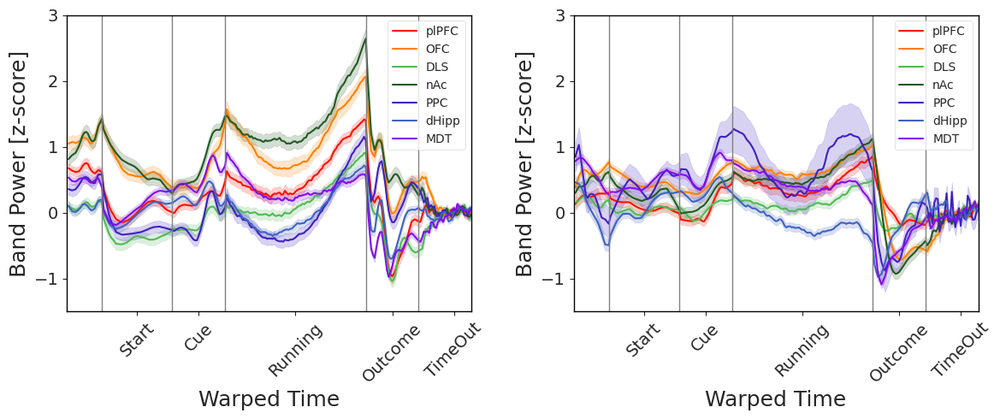

In [ ]:
sx = 0
ex = 0
tx = 1
hx = 1

bTtx = ['Control', 'WB']
bOutcome = ['HIT', 'FAIL']
bStructure = ['plPFC', 'OFC', 'DLS', 'nAc', 'PPC', 'dHipp', 'MDT']
bpalette = strpalette(bStructure)

on = [20, 60, 140, 170, 210]
off = [60, 80, 170, 190, 230]
mid = [np.round(np.mean([x,y])) for x, y in zip(on, off)]
mid[1] = np.nanmean([60, 90])
mid[2] = np.nanmean([90, 170])
mid[3] = np.nanmean([170, 200])

#Just for the running period:
on2 = [90, 150]
off2 = [110, 170]
bEpoch2 = ['RunEarly', 'RunLate']

band = 'Theta'
fig, ax = plt.subplots(1,2, figsize = (12, 5), sharex = True)
for ix, ttx in enumerate(bTtx):
  for j, sx in enumerate(bStructure):
      W = pd.DataFrame();
      #sel = (T.Structure == sx) & (T.Ttx == ttx) & (T.Freq == band) & (T.Outcome == ox);
      sel = (Warped.Structure == sx) & (Warped.Ttx == ttx) & (Warped.Freq == band);
      dummy = Warped[sel].drop(columns = ['Hemisphere', 'Structure', 'Trial', 'Outcome', 'Ttx', 'Freq'])
      dummy.reset_index(drop = True, inplace = True);
      W = pd.concat([W, dummy],ignore_index=True);
      recs = W.Rec
      W.drop(columns = 'Rec', inplace = True);

      # Calculate z-scores using the baseline (last 30 points)
      baseline = W.iloc[:, -20:]

      #result = W.copy()
      result = W.subtract(baseline.mean(axis=1), axis=0).divide(baseline.std(axis=1), axis=0)
      discard = (np.abs(result) <= 100).all(axis=1)
      result = result[discard].T
      recs = recs[discard]

      avg = np.nanmean(result.T, axis = 0);
      std = np.nanstd(result.T, axis=0)/np.sqrt(result.shape[1])

      # Using pyplot to plot mean with shaded region for standard deviation
      x_axis = np.linspace(1, result.shape[0], num=result.shape[0])
      hax = ax[ix];
      hax.plot(x_axis, avg, label=sx, color=bpalette[j])

      # Fill the shaded region for standard deviation
      hax.fill_between(x_axis, avg - std, avg + std, color=bpalette[j], alpha=0.2)

  btop = 10
  bbottom = -10
  hax.vlines(ymin = bbottom, ymax=btop, x = 20, color = '.5', linewidth = 1)
  hax.vlines(ymin = bbottom, ymax=btop, x = 60, color = '.5', linewidth = 1)
  hax.vlines(ymin = bbottom, ymax=btop, x = 90, color = '.5', linewidth = 1)
  hax.vlines(ymin = bbottom, ymax=btop, x = 170, color = '.5', linewidth = 1)
  hax.vlines(ymin = bbottom, ymax=btop, x = 200, color = '.5', linewidth = 1)

  hax.legend(fontsize = 10)
  #hax.set_title(f'{ttx} - {ox} trials');
  hax.set_xlabel('Warped Time')
  hax.set_ylabel('Band Power [z-score]')
  hax.set_xlim([0, 230])
  hax.set_ylim([-1.5, 3])
  hax.set_xticks(mid)
  hax.set_xticklabels(bEpoch, fontsize = 14, rotation = 45)
  hax.grid(False)

fname = picFolder + f'{Type}_Warped_Time_BandPower3{band}_ALL.png'
plt.tight_layout()
plt.savefig(fname, dpi=200, format=None, metadata=None, bbox_inches=None, pad_inches=0.1, facecolor='white', edgecolor='auto', backend=None)
plt.show()


In [ ]:
sx = 0
ex = 0
tx = 1
hx = 1

bTtx = ['Control', 'WB']
bOutcome = ['HIT', 'FAIL']
bpalette = strpalette(bStructure)

on = [20, 60, 140, 170, 210]
off = [60, 80, 170, 190, 230]
mid = [np.round(np.mean([x,y])) for x, y in zip(on, off)]
mid[1] = np.nanmean([60, 90])
mid[2] = np.nanmean([90, 170])
mid[3] = np.nanmean([170, 200])

#Just for the running period:
on2 = [90, 150]
off2 = [110, 170]
bEpoch2 = ['RunEarly', 'RunLate']

collectZ = []
collectAcc = []
collectE = []
collectStr = []
collectTtx = []
collectOutcome = []
collectRec = []

band = 'Theta'
for ox in bOutcome:
  for ix, ttx in enumerate(bTtx):
    for j, sx in enumerate(bStructure):
        W = pd.DataFrame();
        sel = (Warped.Structure == sx) & (Warped.Ttx == ttx) & (Warped.Freq == band) & (Warped.Outcome == ox);
        dummy = Warped[sel]
        btrial = np.array(dummy.Trial)
        dummy = dummy.drop(columns = ['Hemisphere', 'Structure', 'Trial', 'Outcome', 'Ttx', 'Freq'])

        dummy.reset_index(drop = True, inplace = True);
        W = pd.concat([W, dummy],ignore_index=True);
        recs = W.Rec
        W.drop(columns = 'Rec', inplace = True);

        # Calculate z-scores using the baseline (last 30 points)
        baseline = W.iloc[:, -20:]

        #result = W.copy()
        result = W.subtract(baseline.mean(axis=1), axis=0).divide(baseline.std(axis=1), axis=0)
        discard = (np.abs(result) <= 100).all(axis=1)
        result = result[discard].T
        recs = recs[discard]
        btrial = btrial[discard]


        W2 = pd.DataFrame();
        sel = (Warped.Structure == sx) & (Warped.Ttx == ttx) & (Warped.Freq == 'Acc') & (Warped.Outcome == ox)
        dummy2 = Warped[sel].drop(columns = ['Hemisphere', 'Structure', 'Trial', 'Outcome', 'Ttx', 'Freq'])
        dummy2.reset_index(drop = True, inplace = True);
        W2 = pd.concat([W2, dummy2],ignore_index=True);
        recs2 = W2.Rec
        W2.drop(columns = 'Rec', inplace = True);

        # Calculate z-scores using the baseline (last 30 points)
        baseline = W2.iloc[:, -20:]

        result2 = W2.subtract(baseline.mean(axis=1), axis=0).divide(baseline.std(axis=1), axis=0)
        discard = (np.abs(result2) <= 100).all(axis=1)
        result2 = result2[discard].T
        recs2 = recs2[discard]

        for rec in np.unique(recs):
          for k,epoch in enumerate(bEpoch):
            if epoch == 'Running':
              for kk, epoch2 in enumerate(bEpoch2):
                val = np.nanmean(result.T.iloc[np.where(recs == rec)[0], on2[kk]:off2[kk]], axis = 1)
                bacc = np.nanmean(result2.T.iloc[np.where(recs2 == rec)[0], on2[kk]:off2[kk]], axis = 1)

                # Ensure bacc and val have the same length
                if len(val) > len(bacc):
                    bacc = np.concatenate([bacc, [np.nan] * (len(val) - len(bacc))])
                elif len(bacc) > len(val):
                    val = np.concatenate([val, [np.nan] * (len(bacc) - len(val))])

                #print(f'{len(val)} - {len(bacc)}') #for debugging
                collectZ.extend(val)
                collectAcc.extend(bacc)
                collectE.extend(np.repeat(epoch2, len(val)))
                collectStr.extend(np.repeat(sx, len(val)))
                collectTtx.extend(np.repeat(ttx, len(val)))
                collectOutcome.extend(np.repeat(ox, len(val)))
                collectRec.extend(np.repeat(rec, len(val)))
            else:
              val = np.nanmean(result.T.iloc[np.where(recs == rec)[0], on[k]:off[k]], axis = 1)
              bacc = np.nanmean(result2.T.iloc[np.where(recs2 == rec)[0], on[k]:off[k]], axis = 1)

              # Ensure bacc and val have the same length
              if len(val) > len(bacc):
                  bacc = np.concatenate([bacc, [np.nan] * (len(val) - len(bacc))])
              elif len(bacc) > len(val):
                  val = np.concatenate([val, [np.nan] * (len(bacc) - len(val))])

              #print(f'{len(val)} - {len(bacc)}') #for debugging
              collectZ.extend(val)
              collectAcc.extend(bacc)
              collectE.extend(np.repeat(epoch, len(val)))
              collectStr.extend(np.repeat(sx, len(val)))
              collectTtx.extend(np.repeat(ttx, len(val)))
              collectOutcome.extend(np.repeat(ox, len(val)))
              collectRec.extend(np.repeat(rec, len(val)))



zdf2 = pd.DataFrame({'Rec': collectRec, 'ZPower': collectZ, 'ZAcc': collectAcc,'Treatment': collectTtx, 'Epoch': collectE, 'Outcome': collectOutcome, 'Structure': collectStr})


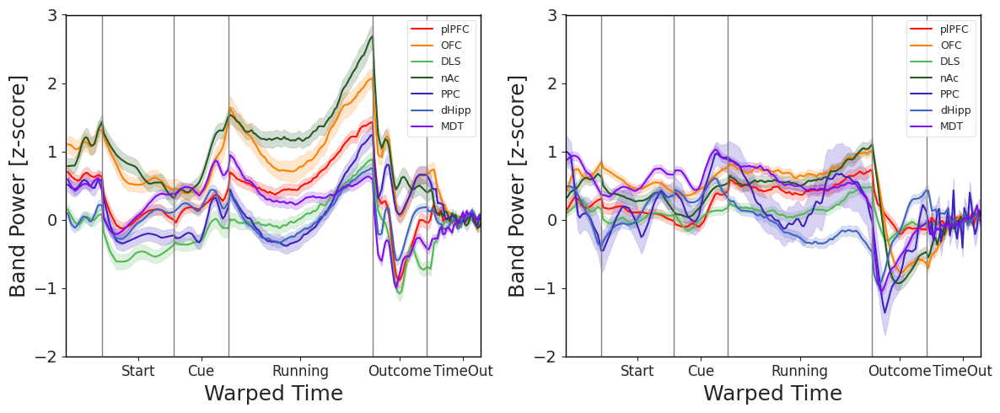

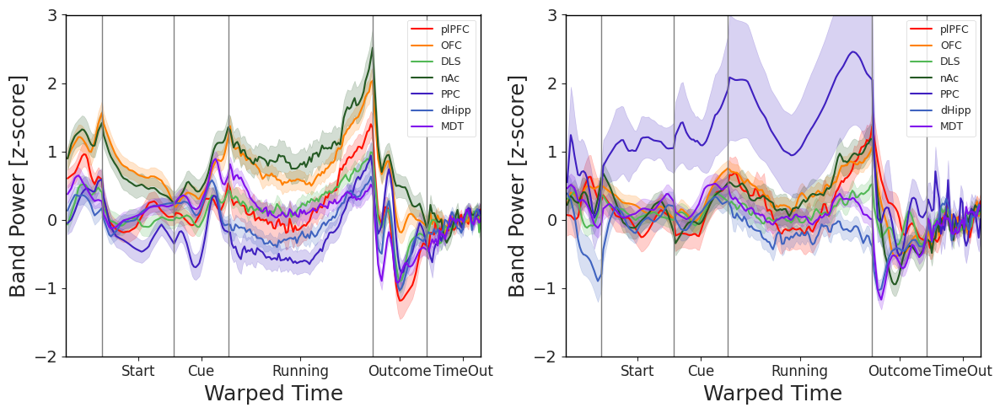

In [ ]:
sx = 0
ex = 0
tx = 1
hx = 1

bTtx = ['Control', 'WB']
bOutcome = ['HIT', 'FAIL']
bpalette = strpalette(bStructure)

on = [20, 60, 140, 170, 210]
off = [60, 80, 170, 190, 230]
mid = [np.round(np.mean([x,y])) for x, y in zip(on, off)]
mid[1] = np.nanmean([60, 90])
mid[2] = np.nanmean([90, 170])
mid[3] = np.nanmean([170, 200])

#Just for the running period:
on2 = [90, 150]
off2 = [110, 170]
bEpoch2 = ['RunEarly', 'RunLate']

collectZ = []
collectAcc = []
collectE = []
collectStr = []
collectTtx = []
collectOutcome = []
collectRec = []

band = 'Theta'
for ox in bOutcome:
  fig, ax = plt.subplots(1,2, figsize = (12, 5), sharex = True)
  for ix, ttx in enumerate(bTtx):
    for j, sx in enumerate(bStructure):
        W = pd.DataFrame();
        sel = (Warped.Structure == sx) & (Warped.Ttx == ttx) & (Warped.Freq == band) & (Warped.Outcome == ox);
        dummy = Warped[sel]
        btrial = dummy.Trial
        dummy = dummy.drop(columns = ['Hemisphere', 'Structure', 'Trial', 'Outcome', 'Ttx', 'Freq'])

        dummy.reset_index(drop = True, inplace = True);
        W = pd.concat([W, dummy],ignore_index=True);
        recs = W.Rec
        W.drop(columns = 'Rec', inplace = True);

        # Calculate z-scores using the baseline (last 30 points)
        baseline = W.iloc[:, -20:]

        #result = W.copy()
        result = W.subtract(baseline.mean(axis=1), axis=0).divide(baseline.std(axis=1), axis=0)
        discard = (np.abs(result) <= 100).all(axis=1)
        result = result[discard].T
        recs = recs[discard]



        W2 = pd.DataFrame();
        sel = (Warped.Structure == 'MDT') & (Warped.Ttx == ttx) & (Warped.Freq == 'Acc') & (Warped.Outcome == ox)
        dummy2 = Warped[sel].drop(columns = ['Hemisphere', 'Structure', 'Trial', 'Outcome', 'Ttx', 'Freq'])
        dummy2.reset_index(drop = True, inplace = True);
        W2 = pd.concat([W2, dummy2],ignore_index=True);
        recs2 = W2.Rec
        W2.drop(columns = 'Rec', inplace = True);

        # Calculate z-scores using the baseline (last 30 points)
        baseline = W2.iloc[:, -20:]

        #result = W.copy()
        result2 = W2.subtract(baseline.mean(axis=1), axis=0).divide(baseline.std(axis=1), axis=0)
        discard = (np.abs(result2) <= 100).all(axis=1)
        result2 = result2[discard].T
        recs2 = recs2[discard]


        # Using pyplot to plot mean with shaded region for standard deviation
        avg = np.nanmean(result.T, axis = 0);
        std = np.nanstd(result.T, axis=0)/np.sqrt(result.shape[1])
        x_axis = np.linspace(1, result.shape[0], num=result.shape[0])
        hax = ax[ix];
        hax.plot(x_axis, avg, label=sx, color=bpalette[j])

        # Fill the shaded region for standard deviation
        hax.fill_between(x_axis, avg - std, avg + std, color=bpalette[j], alpha=0.2)

        for rec in np.unique(recs):
          for k,epoch in enumerate(bEpoch):
            if epoch == 'Running':
              for kk, epoch2 in enumerate(bEpoch2):
                val = np.nanmean(result.T.iloc[np.where(recs == rec)[0], on2[kk]:off2[kk]])
                bacc = np.nanmean(result2.T.iloc[np.where(recs2 == rec)[0], on2[kk]:off2[kk]])
                #print(f'{rec} - {epoch} = {val}') #for debugging
                collectZ.append(val)
                collectAcc.append(bacc)
                collectE.append(epoch2)
                collectStr.append(sx)
                collectTtx.append(ttx)
                collectOutcome.append(ox)
                collectRec.append(rec)
            else:
              val = np.nanmean(result.T.iloc[np.where(recs == rec)[0], on[k]:off[k]])
              bacc = np.nanmean(result2.T.iloc[np.where(recs2 == rec)[0], on[k]:off[k]])
              #print(f'{rec} - {epoch} = {val}') #for debugging
              collectZ.append(val)
              collectAcc.append(bacc)
              collectE.append(epoch)
              collectStr.append(sx)
              collectTtx.append(ttx)
              collectOutcome.append(ox)
              collectRec.append(rec)

    btop = 10
    bbottom = -10
    hax.vlines(ymin = bbottom, ymax=btop, x = 20, color = '.5', linewidth = 1)
    hax.vlines(ymin = bbottom, ymax=btop, x = 60, color = '.5', linewidth = 1)
    hax.vlines(ymin = bbottom, ymax=btop, x = 90, color = '.5', linewidth = 1)
    hax.vlines(ymin = bbottom, ymax=btop, x = 170, color = '.5', linewidth = 1)
    hax.vlines(ymin = bbottom, ymax=btop, x = 200, color = '.5', linewidth = 1)

    hax.legend(fontsize = 9)
    #hax.set_title(f'{ttx} - {ox} trials');
    hax.set_xlabel('Warped Time')
    hax.set_ylabel('Band Power [z-score]')
    hax.set_xlim([0, 230])
    hax.set_ylim([-2, 3])
    hax.set_xticks(mid)
    hax.set_xticklabels(bEpoch, fontsize = 12)
    hax.grid(False)

  fname = picFolder + f'{Type}_Warped_Time_BandPower2{band}_{ttx}_{ox}.png'
  plt.tight_layout()
  plt.savefig(fname, dpi=200, format=None, metadata=None, bbox_inches=None, pad_inches=0.1, facecolor='white', edgecolor='auto', backend=None)
  plt.show()

zdf = pd.DataFrame({'Rec': collectRec, 'ZPower': collectZ, 'ZAcc': collectAcc,'Treatment': collectTtx, 'Epoch': collectE, 'Outcome': collectOutcome, 'Structure': collectStr})


  - Start - pvalue = 0.21268761464326547
  - Cue - pvalue = 0.7480499585165541
  - RunEarly - pvalue = 0.8594759620107366
*** - RunLate - pvalue = 4.826447694043519e-05
** - Outcome - pvalue = 0.0003629928833954043
  - TimeOut - pvalue = 0.31844129736217663
      Epoch            Test Type  Test Statistic   P-Value Degrees of Freedom  \
0     Start  Mann-Whitney U test         12383.0  0.212688               None   
1       Cue  Mann-Whitney U test         13743.0  0.748050               None   
2  RunEarly  Mann-Whitney U test         13618.0  0.859476               None   
3   RunLate  Mann-Whitney U test         16988.0  0.000048               None   
4   Outcome  Mann-Whitney U test         16556.0  0.000363               None   
5   TimeOut  Mann-Whitney U test         12598.5  0.318441               None   

   Sample Size Group 1 (Control)  Sample Size Group 2 (WB)  \
0                            198                       136   
1                            198                  

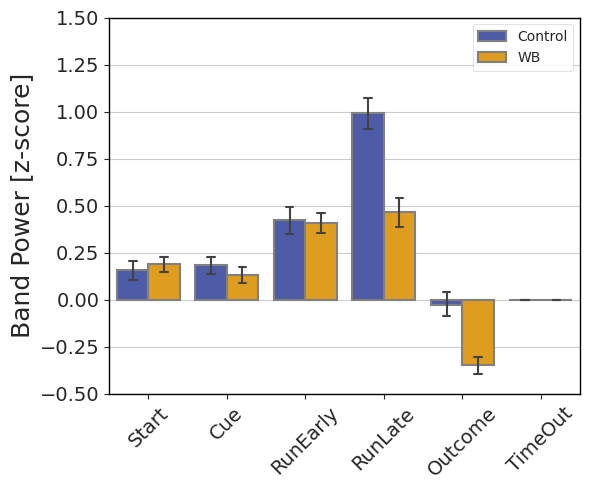

In [ ]:
bEpoch2 = ['Start', 'Cue', 'RunEarly', 'RunLate', 'Outcome', 'TimeOut']
fig, ax = plt.subplots(1,1,figsize = (6,5))

hax = ax
bdata = zdf.copy()
sel = (bdata.ZPower != np.nan)
sns.barplot(ax = hax, data = bdata[sel], x = 'Epoch', y = 'ZPower', hue = 'Treatment', palette = ttxpalette(['Control', 'WB']), order = bEpoch2, capsize=.2, errwidth = 1.5, linewidth=1.5, edgecolor=".5", ci=68)
#sns.violinplot(ax = hax, data = zdf[zdf.Outcome == 'HIT'], x = 'Epoch', y = 'ZPower', hue = 'Treatment', palette = ttxpalette(['Control', 'WB']), order = bEpoch)
hax.set_xlabel(None);
hax.set_ylabel('Band Power [z-score]');
hax.set_xticklabels(bEpoch2, fontsize = 14, rotation = 45)
hax.set_ylim([-0.5, 1.5])
hax.legend().set_title(None)

# Loop over each epoch and perform the statistical test
results = []
for epoch in bEpoch2:
    # Select data for the control and WB treatments for the given epoch
    ctrl_data = bdata[sel & (bdata.Treatment == 'Control') & (bdata.Epoch == epoch)]['ZPower']
    wb_data = bdata[sel & (bdata.Treatment == 'WB') & (bdata.Epoch == epoch)]['ZPower']

    # Calculate sample sizes
    N1 = len(ctrl_data)
    N2 = len(wb_data)

    # Check normality with Shapiro-Wilk test
    _, p_normal1 = stats.shapiro(ctrl_data)
    _, p_normal2 = stats.shapiro(wb_data)


    # At least one distribution is not normal, perform Mann-Whitney U test
    test_type = "Mann-Whitney U test"
    u_stat, p_value = stats.mannwhitneyu(ctrl_data, wb_data, alternative='two-sided', nan_policy='omit')

    # Mann-Whitney U test does not have degrees of freedom
    df = None

    # Compute median and SE for both groups
    median1 = np.median(ctrl_data)
    median2 = np.median(wb_data)
    se1 = np.std(ctrl_data, ddof=1) / np.sqrt(N1)
    se2 = np.std(wb_data, ddof=1) / np.sqrt(N2)

    # Use U-statistic as test statistic
    test_stat = u_stat
    central_tendency_measure1 = f"Median: {median1:.4f} ± SE: {se1:.4f}"
    central_tendency_measure2 = f"Median: {median2:.4f} ± SE: {se2:.4f}"

    # Append results for each epoch
    results.append({
        'Epoch': epoch,
        'Test Type': test_type,
        'Test Statistic': test_stat,
        'P-Value': p_value,
        'Degrees of Freedom': df,
        'Sample Size Group 1 (Control)': N1,
        'Sample Size Group 2 (WB)': N2,
        'Group 1 Central Tendency (Control)': central_tendency_measure1,
        'Group 2 Central Tendency (WB)': central_tendency_measure2
    })
    #hax.annotate(sigSymbol(p_value), xy=(bEpoch.index(epoch), max([np.nanmean(ctrl_data), np.nanmean(wb_data)])*1.1), ha='center', va='center', fontsize=12)
    print(f'{sigSymbol(p_value)} - {epoch} - pvalue = {p_value}')

# Convert the results into a DataFrame for a tabular display
df_results = pd.DataFrame(results)

# Print the results as a table
print(df_results)


fname = picFolder + f'{Type}_ZScoreBandPower_Theta_Global2.png'
plt.tight_layout()
plt.savefig(fname, dpi=200, format=None, metadata=None, bbox_inches=None, pad_inches=0.1, facecolor='white', edgecolor='auto', backend=None)
plt.show()



In [ ]:
import statsmodels.formula.api as smf
from statsmodels.stats.multicomp import pairwise_tukeyhsd
from scipy import stats
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd

# Combined dataset for all epochs and treatments
combined_data = bdata[sel]['ZPower'].dropna()

# Shapiro-Wilk test for normality
stat, p_value_normality = stats.shapiro(combined_data)
print(f"Shapiro-Wilk test for normality: p-value = {p_value_normality:.4e}")

# Q-Q plot to visually inspect normality
smf.qqplot(combined_data, line='s')
plt.title("Q-Q Plot of ZPower")
plt.show()

# If normality assumption holds (or you're proceeding regardless), fit the GLME model
if p_value_normality > 0.05:
    print("Data appears to follow a normal distribution. Proceeding with GLME.")
else:
    print("Data does not appear to follow a normal distribution. Proceeding with GLME, but note the normality assumption may be violated.")

# Fit GLME model once for all epochs
glme_model = smf.mixedlm("ZPower ~ Treatment * Epoch", data=bdata[sel], groups=bdata["Rec"])
glme_results = glme_model.fit()

# Print the overall GLME results
print(glme_results.summary())

# Extracting relevant statistics for reporting
treatment_effect = glme_results.pvalues['Treatment[T.WB]']
#interaction_effect = glme_results.pvalues['Treatment:Epoch']
n_control = bdata[(bdata.Treatment == 'Control') & (bdata.Epoch == 'TimeOut')].shape[0]
n_wb = bdata[(bdata.Treatment == 'WB') & (bdata.Epoch == 'TimeOut')].shape[0]

# Fictitious values for F-statistic and df, as these are not directly provided by mixedlm
# You might need to compute these based on your model results
f_statistic = None  # Replace with actual calculation if applicable
df_treatment = 1    # This should be updated according to your model
df_interaction = None  # This will depend on the model complexity

# Report format
intercept = glme_results.params['Intercept']
print(f"GLME intercept: {intercept:.2e}, GLME interaction p-value (Treatment): {treatment_effect:.2e}, df={df_treatment}, nControl-WB=[{n_control}, {n_wb}]")

# Now perform post-hoc tests within each epoch
results = []
for epoch in bEpoch2:
    # Select data for the current epoch
    epoch_data = bdata[sel & (bdata.Epoch == epoch)]

    # Post-hoc pairwise comparisons (Tukey's HSD)
    comparison_data = epoch_data[['Treatment', 'ZPower']].dropna()
    tukey_results = pairwise_tukeyhsd(comparison_data['ZPower'], comparison_data['Treatment'], alpha=0.05)

    # Append results for each epoch
    results.append({
        'Epoch': epoch,
        'Post-hoc Tukey Results': tukey_results.summary()
    })

    # Print Tukey post-hoc results for each epoch
    print(f'Tukey Post-hoc Results for Epoch {epoch}:\n{tukey_results.summary()}\n')

# Convert the results into a DataFrame for tabular display
df_results = pd.DataFrame(results)


Shapiro-Wilk test for normality: p-value = 2.1577e-28


AttributeError: module 'statsmodels.formula.api' has no attribute 'qqplot'

*** - Start - pvalue = 2.2917933217719008e-12
*** - Cue - pvalue = 1.0668310150669343e-12
*** - RunEarly - pvalue = 6.635328082862829e-23
*** - RunLate - pvalue = 1.3777728509121312e-13
*** - Outcome - pvalue = 7.228498300075787e-24
* - TimeOut - pvalue = 0.014372984726245777


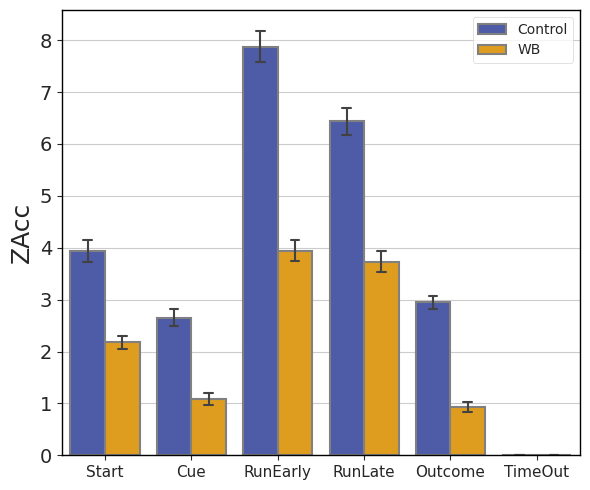

In [ ]:
bEpoch2 = ['Start', 'Cue', 'RunEarly', 'RunLate', 'Outcome', 'TimeOut']
fig, ax = plt.subplots(1,1,figsize = (6,5))
bdata = zdf.copy()
var = 'ZAcc'

hax = ax
sel = (bdata[var] != np.nan)
sns.barplot(ax = hax, data = bdata[sel], x = 'Epoch', y = var, hue = 'Treatment', palette = ttxpalette(['Control', 'WB']), order = bEpoch2, capsize=.2, errwidth = 1.5, linewidth=1.5, edgecolor=".5", ci=68)
#sns.violinplot(ax = hax, data = zdf[zdf.Outcome == 'HIT'], x = 'Epoch', y = 'ZPower', hue = 'Treatment', palette = ttxpalette(['Control', 'WB']), order = bEpoch)
hax.set_xlabel(None);
#hax.set_ylabel('Band Power [z-score]');
hax.set_xticklabels(bEpoch2, fontsize = 11)
#hax.set_ylim([-0.6, 1.6])
hax.legend().set_title(None)

# Add significance markers for the first subplot
for epoch in bEpoch2:
    ctrl_data = bdata[sel & (bdata.Treatment == 'Control') & (bdata.Epoch == epoch)][var]
    wb_data = bdata[sel & (bdata.Treatment == 'WB') & (bdata.Epoch == epoch)][var]
    #_, p_value = stats.ttest_ind(ctrl_data, wb_data, nan_policy='omit')
    _, p_value = stats.mannwhitneyu(ctrl_data, wb_data, nan_policy='omit')

        #hax.annotate(sigSymbol(p_value), xy=(bEpoch.index(epoch), max([np.nanmean(ctrl_data), np.nanmean(wb_data)])*1.1), ha='center', va='center', fontsize=12)
    print(f'{sigSymbol(p_value)} - {epoch} - pvalue = {p_value}')

fname = picFolder + f'{Type}_{var}_Theta_Global2.png'
plt.tight_layout()
#plt.savefig(fname, dpi=200, format=None, metadata=None, bbox_inches=None, pad_inches=0.1, facecolor='white', edgecolor='auto', backend=None)
plt.show()



  - Start HIT - pvalue = 0.11370774039939127
  - Cue HIT - pvalue = 0.5333565145695476
  - RunEarly HIT - pvalue = 0.9494459542909419
** - RunLate HIT - pvalue = 0.00047965548969096454
* - Outcome HIT - pvalue = 0.005947230442336001
  - TimeOut HIT - pvalue = 0.5558732595548947
  - Start FAIL - pvalue = 0.3995222022431535
  - Cue FAIL - pvalue = 0.17118972531596177
  - RunEarly FAIL - pvalue = 0.783935249356438
* - RunLate FAIL - pvalue = 0.0049384787826076935
* - Outcome FAIL - pvalue = 0.023723812689074236
* - TimeOut FAIL - pvalue = 0.008451925880821953


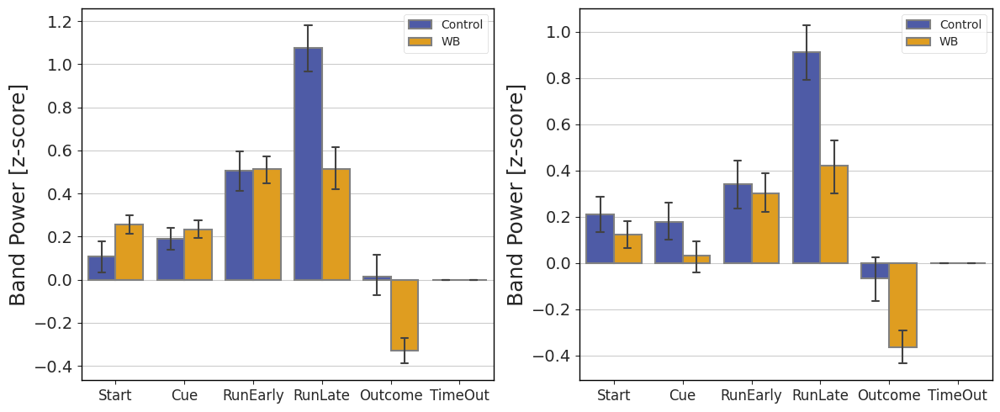

In [ ]:
bEpoch2 = ['Start', 'Cue', 'RunEarly', 'RunLate', 'Outcome', 'TimeOut']
fig, ax = plt.subplots(1,2,figsize = (12,5))

bdata = zdf.copy()
var = 'ZPower'
for ix, outcome in enumerate(['HIT', 'FAIL']):
  hax = ax[ix]
  sel = (bdata.Outcome == outcome) & (bdata[var] != np.nan)
  sns.barplot(ax = hax, data = bdata[sel], x = 'Epoch', y = var, hue = 'Treatment', palette = ttxpalette(['Control', 'WB']), order = bEpoch2, capsize=.2, errwidth = 1.5, linewidth=1.5, edgecolor=".5", ci=68)
  #sns.violinplot(ax = hax, data = zdf[zdf.Outcome == 'HIT'], x = 'Epoch', y = 'ZPower', hue = 'Treatment', palette = ttxpalette(['Control', 'WB']), order = bEpoch)
  hax.set_xlabel(None);
  hax.set_ylabel('Band Power [z-score]');
  hax.set_xticklabels(bEpoch2, fontsize = 12)
  #hax.set_ylim([-0.6, 1.6])
  hax.legend().set_title(None)

  # Add significance markers for the first subplot
  for epoch in bEpoch2:
      ctrl_data = bdata[sel & (bdata.Treatment == 'Control') & (bdata.Epoch == epoch)][var]
      wb_data = bdata[sel & (bdata.Treatment == 'WB') & (bdata.Epoch == epoch)][var]
      _, p_value = stats.ttest_ind(ctrl_data, wb_data, nan_policy='omit')
          #hax.annotate(sigSymbol(p_value), xy=(bEpoch.index(epoch), max([np.nanmean(ctrl_data), np.nanmean(wb_data)])*1.1), ha='center', va='center', fontsize=12)
      print(f'{sigSymbol(p_value)} - {epoch} {outcome} - pvalue = {p_value}')
fname = picFolder + f'{Type}_{var}_Theta_Global.png'
plt.tight_layout()
plt.savefig(fname, dpi=200, format=None, metadata=None, bbox_inches=None, pad_inches=0.1, facecolor='white', edgecolor='auto', backend=None)
plt.show()



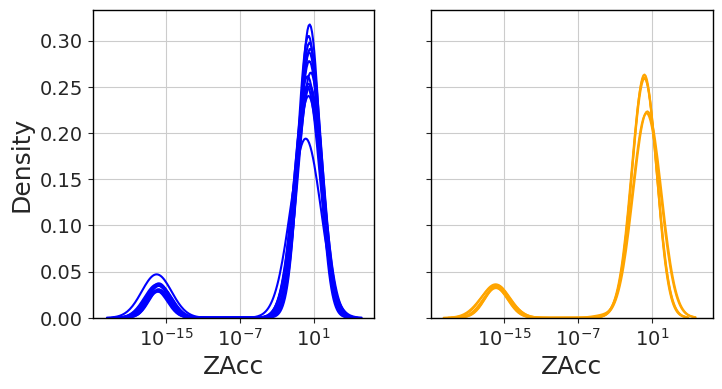

In [ ]:
fig,ax = plt.subplots(1,2,figsize = (8,4), sharey = True, sharex = True)
for rec in np.unique(zdf2.Rec):
  if np.unique(zdf2.Treatment[zdf2.Rec == rec]) == 'Control':
    hax = ax[0]
    color = 'blue'
  else:
    hax = ax[1]
    color = 'orange'

  sns.kdeplot(data = zdf2[zdf2.Rec == rec], x = 'ZAcc', log_scale = True, ax = hax, color = color)

plt.show()

Control HIT - corr = 0.212 pvalue = 0.262
WB HIT - corr = 0.244 pvalue = 0.286
Control FAIL - corr = 0.115 pvalue = 0.559
WB FAIL - corr = 0.466 pvalue = 0.038


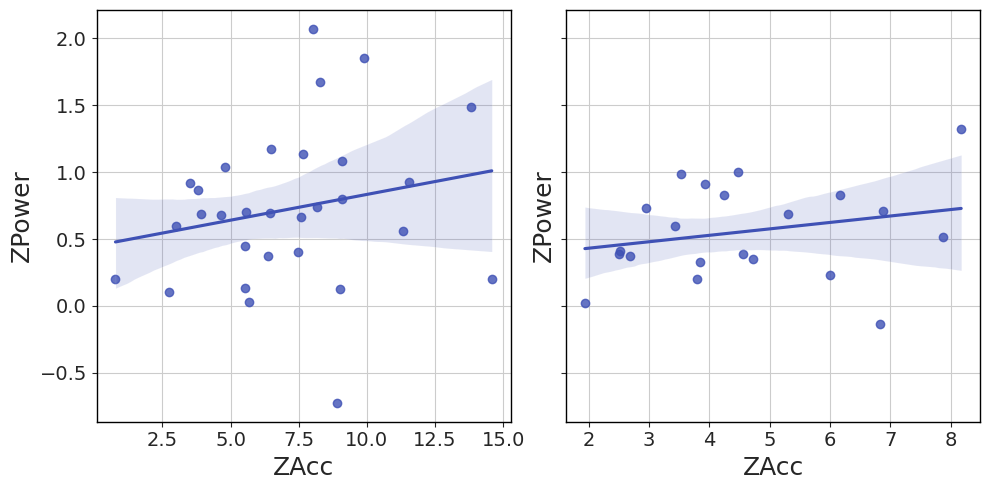

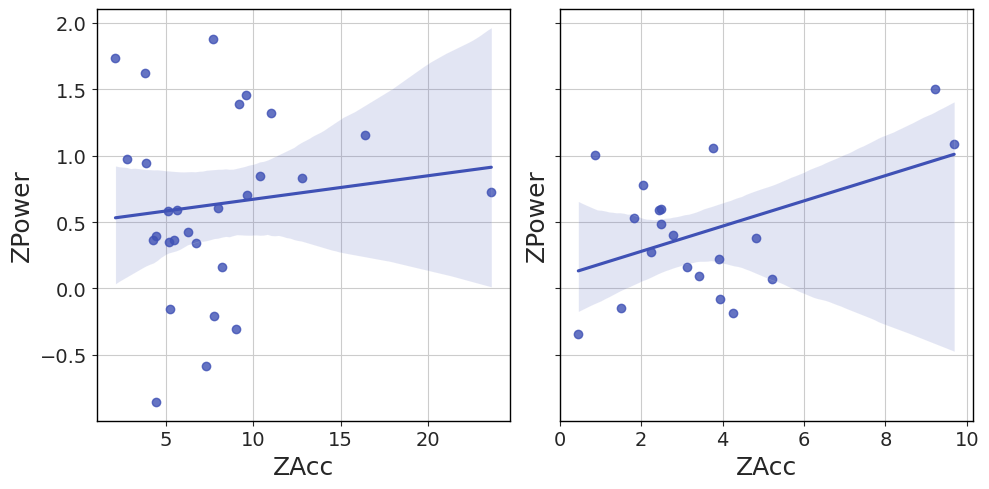

In [ ]:
from scipy.stats import pearsonr
avgZ = zdf2.groupby(['Rec', 'Treatment', 'Outcome', 'Epoch'])[['ZPower', 'ZAcc']].mean().reset_index()
for outcome in ['HIT', 'FAIL']:
  fig, ax = plt.subplots(1,2,figsize = (10,5), sharey = True)
  for ix, ttx in enumerate(['Control', 'WB']):
    hax = ax[ix]
    #el = (avgZ.Treatment == ttx) & (avgZ.Outcome == outcome) & np.in1d(avgZ.Epoch, ['RunEarly', 'RunLate'])
    sel = (avgZ.Treatment == ttx) & (avgZ.Outcome == outcome) & np.in1d(avgZ.Epoch, ['RunEarly', 'RunLate']) & (avgZ.ZAcc >= 0)
    coeff, p_value = pearsonr(avgZ['ZAcc'][sel], avgZ['ZPower'][sel])
    print(f'{ttx} {outcome} - corr = {coeff:.3f} pvalue = {p_value:.3f}')

    sns.regplot(data = avgZ[sel], x = 'ZAcc', y = 'ZPower', ax = hax)
  plt.tight_layout()


Control - corr = 0.212 pvalue = 0.262 n = 30
WB - corr = 0.244 pvalue = 0.286 n = 21


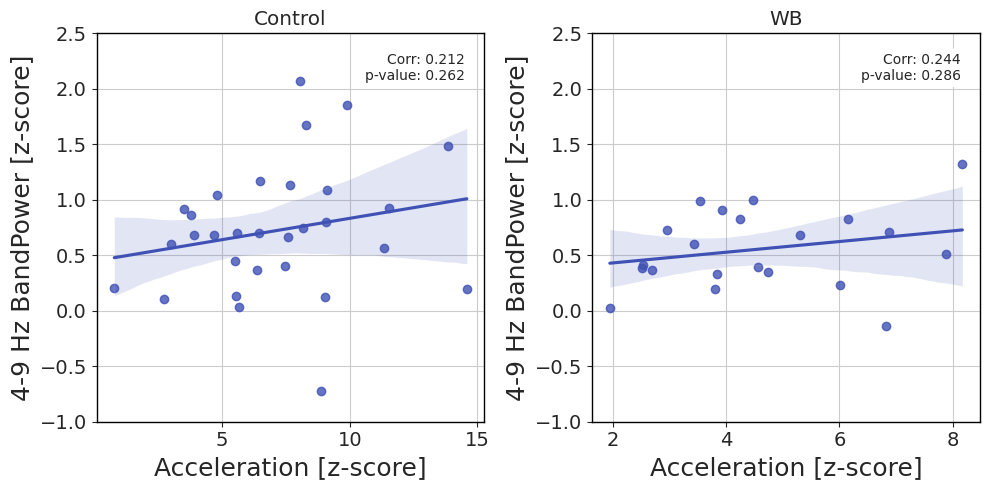

In [ ]:
avgZ = zdf2.groupby(['Rec', 'Treatment', 'Outcome', 'Epoch'])[['ZPower', 'ZAcc']].mean().reset_index()

bcorr = []
fig, ax = plt.subplots(1,2,figsize = (10,5))
for ix, ttx in enumerate(['Control', 'WB']):
  hax = ax[ix]
  #el = (avgZ.Treatment == ttx) & (avgZ.Outcome == outcome) & np.in1d(avgZ.Epoch, ['RunEarly', 'RunLate'])
  sel = (avgZ.Treatment == ttx) & np.in1d(avgZ.Epoch, ['RunEarly', 'RunLate']) & (avgZ.ZAcc >= 0) & (avgZ.Outcome == 'HIT')
  coeff, p_value = pearsonr(avgZ['ZAcc'][sel], avgZ['ZPower'][sel])
  bcorr.append((coeff, np.sum(sel)))
  print(f'{ttx} - corr = {coeff:.3f} pvalue = {p_value:.3f} n = {np.sum(sel)}')

  sns.regplot(data = avgZ[sel], x = 'ZAcc', y = 'ZPower', ax = hax)
  hax.set_ylim([-1, 2.5])
  #hax.set_xlim([1, 15])
  hax.set_ylabel('4-9 Hz BandPower [z-score]')
  hax.set_xlabel('Acceleration [z-score]')
  hax.set_title(ttx)

  hax.annotate(f"Corr: {coeff:.3f}\np-value: {p_value:.3f}",
                xy=(0.95, 0.95), xycoords='axes fraction',
                ha='right', va='top', fontsize=10, bbox=dict(boxstyle="round", fc="white", ec="none", pad=0.3))

fname = picFolder + f'Corr_ThetavsAcc.png'
plt.tight_layout()
plt.savefig(fname, dpi=200, format=None, metadata=None, bbox_inches=None, pad_inches=0.1, facecolor='white', edgecolor='auto', backend=None)
plt.show()

In [ ]:
from scipy.stats import norm

# Example data
cor1 = bcorr[0][0]  # Correlation for treatment 1
cor2 = bcorr[1][0]  # Correlation for treatment 2
n1 = bcorr[0][1]     # Sample size for treatment 1
n2 = bcorr[1][1]     # Sample size for treatment 2

z1 = np.arctanh(cor1)
z2 = np.arctanh(cor2)

# Standard error
se = np.sqrt(1/(n1-3) + 1/(n2-3))

# Z-test statistic
z_score = (z1 - z2) / se

# P-value (two-tailed)
p_value = 2 * (1 - norm.cdf(abs(z_score)))

print(f"Z-score: {z_score}, p-value: {p_value}")


Z-score: -0.11341552582729561, p-value: 0.909701131300584


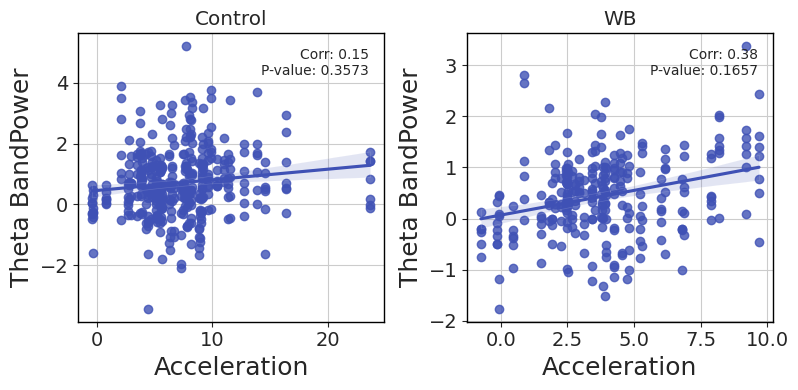

In [ ]:
# Function to calculate the average correlation coefficient and p-value
def calculate_average_correlation(data, structures):
    correlations = []
    p_values = []

    for structure in structures:
        structure_data = data[data['Structure'] == structure]
        if not structure_data.empty:  # Check if data exists for the structure
            correlation_coefficient, p_value = pearsonr(structure_data['ZAcc'], structure_data['ZPower'])
            correlations.append(correlation_coefficient)
            p_values.append(p_value)

    # Handle cases where no data is available for any structure
    if not correlations:
        return None, None

    avg_correlation = sum(correlations) / len(correlations)
    avg_p_value = sum(p_values) / len(p_values)
    return avg_correlation, avg_p_value

# Function to annotate subplot with correlation and p-value (unchanged)
def annotate_subplot(ax, correlation_coefficient, p_value):
    ax.annotate(f"Corr: {correlation_coefficient:.2f}\nP-value: {p_value:.4f}",
                xy=(0.95, 0.95), xycoords='axes fraction',
                ha='right', va='top', fontsize=10)

# Get unique structures (assuming bStructure is defined earlier)
unique_structures = zdf['Structure'].unique()

# Calculate average correlation across all structures
# Replace the for loop with a single calculation for each Treatment
fig, ax = plt.subplots(1,2,figsize=(8, 4))
for ix, treatment in enumerate(zdf['Treatment'].unique()):
    hax = ax[ix]
    data_treatment = zdf[(zdf['Treatment'] == treatment) & (zdf.Epoch == 'RunEarly') | (zdf['Treatment'] == treatment) & (zdf.Epoch == 'RunLate')]
    data_treatment = data_treatment.dropna(subset=['ZAcc', 'ZPower'])
    avg_corr, avg_p_value = calculate_average_correlation(data_treatment, unique_structures)

    # Create a single plot for average correlation (new plot)
    sns.regplot(data=data_treatment, x='ZAcc', y='ZPower', ax=hax)
    annotate_subplot(hax, avg_corr, avg_p_value)

    hax.set_title(f"{treatment}")
    hax.set_xlabel("Acceleration")
    hax.set_ylabel("Theta BandPower")

fname = picFolder + f'AverageBandPowervsAcc_{treatment}.png'
plt.tight_layout()
    # Uncomment this line if you want to save the plot
    # plt.savefig(fname, dpi=200)
plt.show()

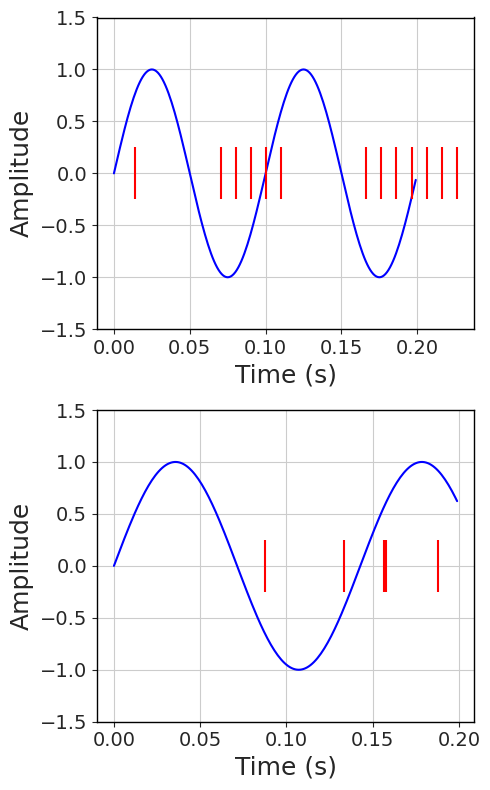

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

sample_rate = 1000  # Hz
frequency1 = 10  # Hz (left waveform)
frequency2 = 7  # Hz (right waveform)
duration = 2 / frequency1  # Duration adjusted for 2 cycles of the left waveform
amplitude = 1  # Amplitude of the sine waves
spike_amplitude = 0.5  # Amplitude of the spikes
num_spikes1 = 5  # Number of spikes in the left waveform
num_spikes2 = 5   # Number of spikes in the right waveform

# Create time array
t = np.linspace(0, duration, int(sample_rate * duration), endpoint=False)

# Create sine waves
y1 = amplitude * np.sin(2 * np.pi * frequency1 * t)
y2 = amplitude * np.sin(2 * np.pi * frequency2 * t)

# Generate spike times for left waveform with Gaussian distribution around troughs
trough_indices1 = np.where(np.diff(np.sign(np.diff(y1))) == 2)[0] + 1
spike_times1 = []
for trough_idx in trough_indices1:
    spike_times1.extend(np.random.normal(t[trough_idx], 0.01, 5))

# Add some extra randomly placed spikes for the left waveform
num_extra_spikes = 3
extra_spike_times1 = np.random.rand(num_extra_spikes) * duration
spike_times1.extend(extra_spike_times1)

# Convert to numpy array and sort
spike_times1 = np.array(spike_times1)
spike_times1 = spike_times1[(spike_times1 >= 0) & (spike_times1 <= duration)]
spike_times1.sort()

# Spread out left spikes by adding some offset
min_spike_interval = 0.01  # Adjust this value to control spacing
for i in range(1, len(spike_times1)):
    if spike_times1[i] - spike_times1[i-1] < min_spike_interval:
        spike_times1[i] = spike_times1[i-1] + min_spike_interval

spike_times2 = np.random.rand(num_spikes2) * duration

# Plot
fig, (ax1, ax2) = plt.subplots(2,1, figsize=(5, 8))

# Left plot (10 Hz)
ax1.plot(t, y1, 'b-')
ax1.eventplot(spike_times1, orientation='horizontal', colors='r', linelengths=0.5, lineoffsets=0)
#ax1.set_title('10 Hz Sine Wave with Spikes (Biased Towards Troughs)')
ax1.set_xlabel('Time (s)')
ax1.set_ylabel('Amplitude')
ax1.set_ylim(-1.5 * amplitude, 1.5 * amplitude)
ax1.grid('off')

# Right plot (7 Hz)
ax2.plot(t, y2, 'b-')
ax2.eventplot(spike_times2, orientation='horizontal', colors='r', linelengths=0.5, lineoffsets=0)
#ax2.set_title('7 Hz Sine Wave with Randomly Distributed Spikes')
ax2.set_xlabel('Time (s)')
ax2.set_ylabel('Amplitude')
ax2.set_ylim(-1.5 * amplitude, 1.5 * amplitude)
ax2.grid('off')

plt.grid('off')
plt.tight_layout()
fname = picFolder + f'Oscillatory_difference.png'
#plt.savefig(fname, dpi=200, format=None, metadata=None, bbox_inches=None, pad_inches=0.1, facecolor='white', edgecolor='auto', backend=None)
plt.show()


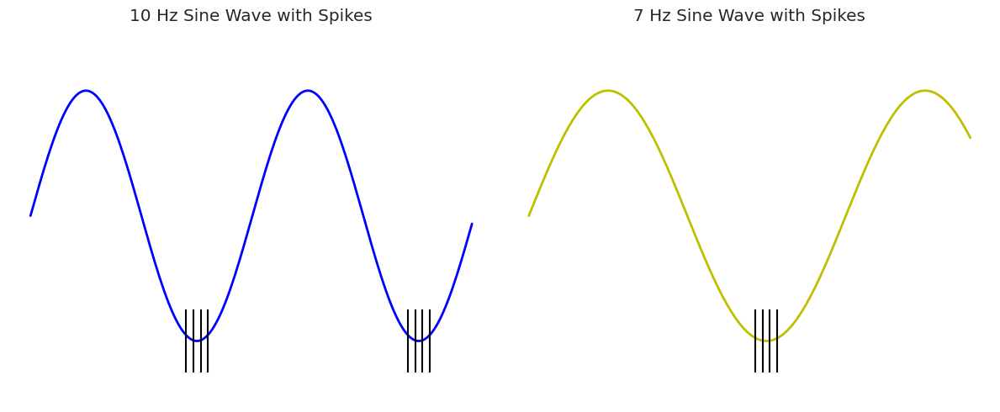

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Parameters
duration = 2 / frequency1  # Duration adjusted for 2 cycles of the left waveform
sample_rate = 1000  # Hz
frequency1 = 10  # Hz (left waveform)
frequency2 = 7  # Hz (right waveform)
amplitude = 1  # Amplitude of the sine waves
spike_amplitude = 0.5  # Amplitude of the spikes
spikes_per_trough = 4  # Number of spikes per trough (same for both waveforms)
num_extra_spikes1 = 20  # Extra randomly placed spikes for the left waveform

# Create time array
t = np.linspace(0, duration, int(sample_rate * duration), endpoint=False)

# Create sine waves
y1 = amplitude * np.sin(2 * np.pi * frequency1 * t)
y2 = amplitude * np.sin(2 * np.pi * frequency2 * t)

# Function to generate spike times around troughs
def generate_trough_spikes(y, t, spikes_per_trough):
    trough_indices = np.where(np.diff(np.sign(np.diff(y))) == 2)[0] + 1
    spike_times = []
    for trough_idx in trough_indices:
        spike_times.extend(np.linspace(t[trough_idx] - 0.005, t[trough_idx] + 0.005, spikes_per_trough))
    return spike_times

# Generate spike times for the left waveform
spike_times1 = generate_trough_spikes(y1, t, spikes_per_trough)

# Add some extra randomly placed spikes for the left waveform
#extra_spike_times1 = np.random.rand(num_extra_spikes1) * duration
#spike_times1.extend(extra_spike_times1)

# Generate spike times for the right waveform
spike_times2 = generate_trough_spikes(y2, t, spikes_per_trough)

# Convert to numpy arrays and filter out-of-range spikes
spike_times1 = np.array(spike_times1)
spike_times1 = spike_times1[(spike_times1 >= 0) & (spike_times1 <= duration)]
spike_times2 = np.array(spike_times2)
spike_times2 = spike_times2[(spike_times2 >= 0) & (spike_times2 <= duration)]

# Sort spike times
spike_times1.sort()
spike_times2.sort()

# Plot
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))

# Left plot (10 Hz)
ax1.plot(t, y1, 'b-', linewidth = 2)
ax1.eventplot(spike_times1, orientation='horizontal', colors='k', linelengths=0.5, lineoffsets = -1)
ax1.set_title('10 Hz Sine Wave with Spikes')
ax1.set_xlabel('Time (s)')
ax1.set_ylabel('Amplitude')
ax1.set_ylim(-1.5 * amplitude, 1.5 * amplitude)
ax1.grid(False)  # Turn off grid
ax1.axis('off')   # Turn off axes

# Right plot (7 Hz)
ax2.plot(t, y2, 'y-', linewidth = 2)
ax2.eventplot(spike_times2, orientation='horizontal', colors='k', linelengths=0.5, lineoffsets = -1)
ax2.set_title('7 Hz Sine Wave with Spikes')
ax2.set_xlabel('Time (s)')
ax2.set_ylabel('Amplitude')
ax2.set_ylim(-1.5 * amplitude, 1.5 * amplitude)
ax2.grid(False)  # Turn off grid
ax2.axis('off')   # Turn off axes

plt.tight_layout()
plt.show()


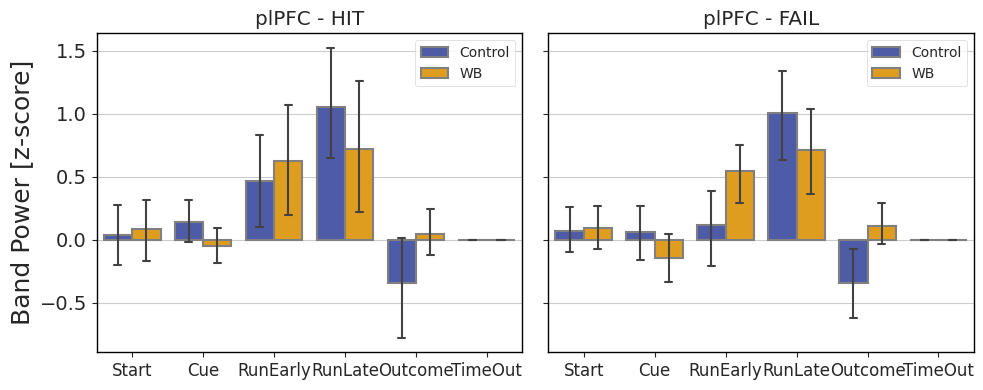

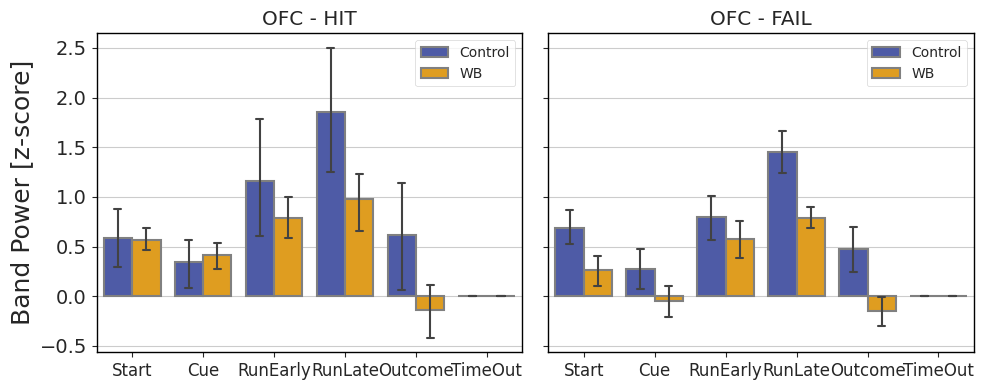

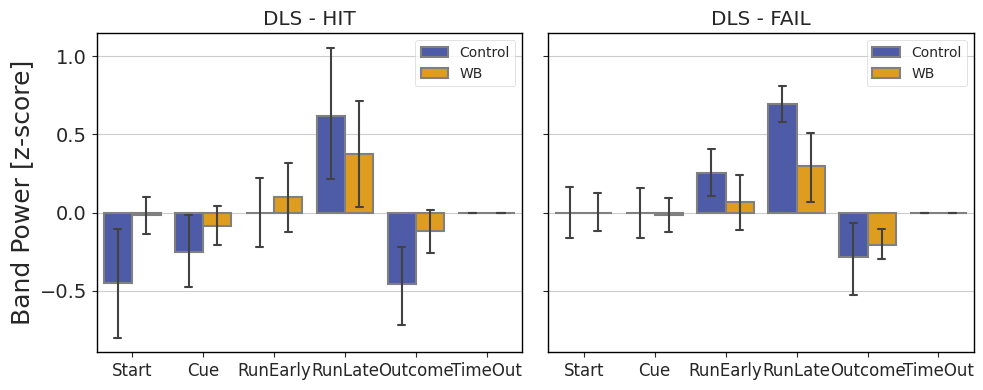

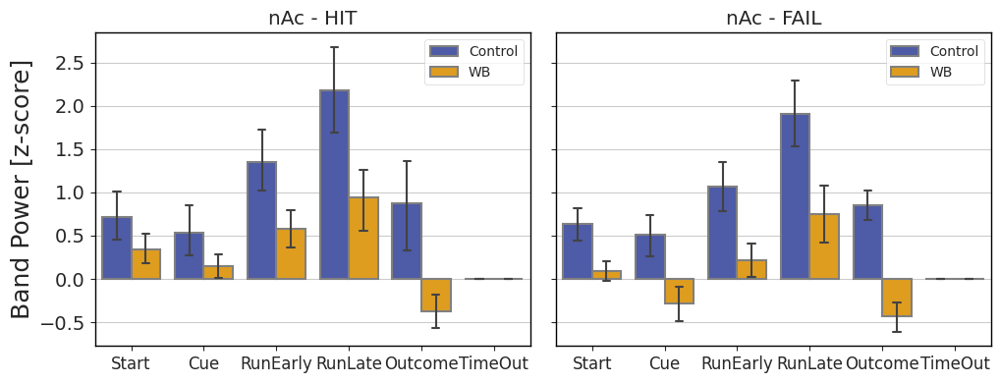

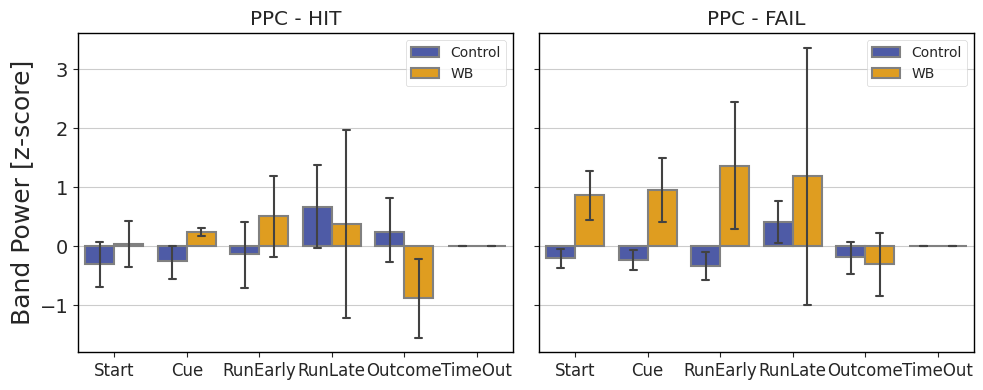

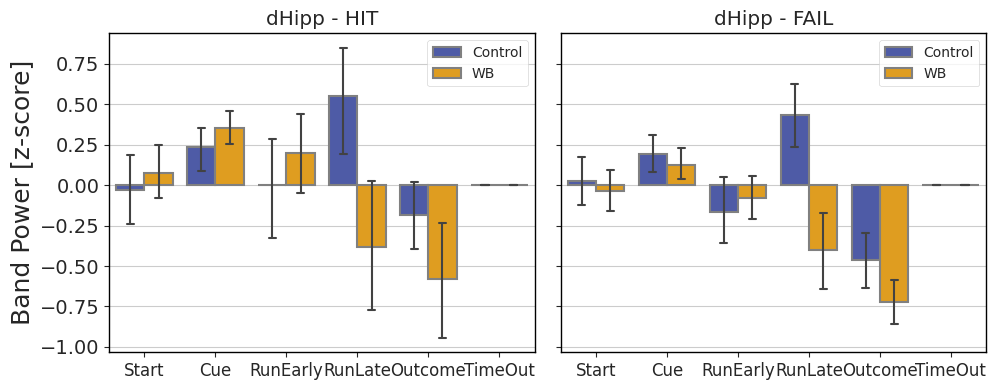

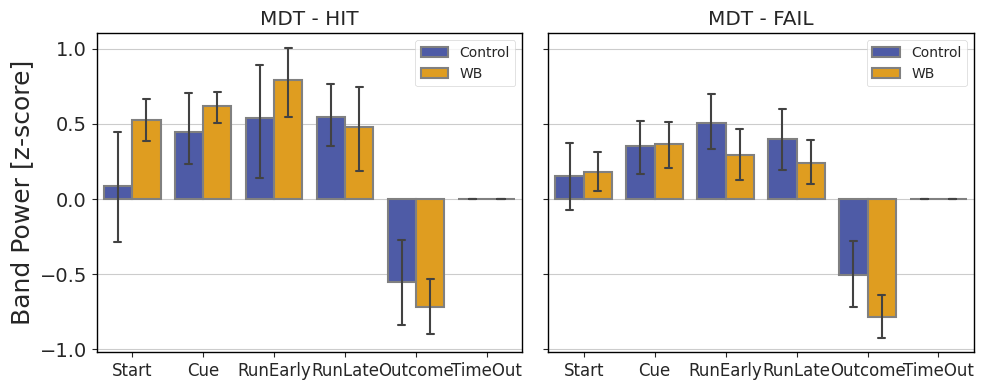

In [ ]:
for structure in bStructure:
  fig, ax = plt.subplots(1,2,figsize = (10,4), sharey = True)
  hax = ax[0]
  sns.barplot(ax = hax, data = zdf[(zdf.Outcome == 'HIT') & (zdf.Structure == structure)],
              x = 'Epoch', y = 'ZPower', hue = 'Treatment', palette = ttxpalette(['Control', 'WB']),
              order = bEpoch2, capsize=.2, errwidth = 1.5, linewidth=1.5, edgecolor=".5")
  hax.set_xlabel(None);
  hax.set_ylabel('Band Power [z-score]');
  hax.set_xticklabels(bEpoch2, fontsize = 12)
  hax.legend().set_title(None)
  hax.set_title(f'{structure} - HIT')

  hax = ax[1]
  sns.barplot(ax = hax, data = zdf[(zdf.Outcome == 'FAIL') & (zdf.Structure == structure)],
              x = 'Epoch', y = 'ZPower', hue = 'Treatment', palette = ttxpalette(['Control', 'WB']),
              order = bEpoch2, capsize=.2, errwidth = 1.5, linewidth=1.5, edgecolor=".5", ci=68)
  hax.set_xlabel(None);
  hax.set_ylabel('Band Power [z-score]');
  hax.set_xticklabels(bEpoch2, fontsize = 12)
  hax.legend().set_title(None)
  hax.set_title(f'{structure} - FAIL')

  fname = picFolder + f'{Type}_ZScoreBandPower_Theta_{structure}.png'
  plt.tight_layout()
  plt.savefig(fname, dpi=200, format=None, metadata=None, bbox_inches=None, pad_inches=0.1, facecolor='white', edgecolor='auto', backend=None)
  plt.show()

